# MIBI data using SCYAN
Teresa, Version September 2023

Tutorials available on: https://mics-lab.github.io/scyan/

In [1]:
#Importing the relevant libraries

import os
import gc
import random
import numpy as np
import pandas as pd
import seaborn as sns 
import anndata as ad
import scyan
import scanpy as sc
import squidpy as sq
from matplotlib import rcParams
import matplotlib.pyplot as plt
from pathlib import Path
from scipy import stats
import warnings
from skimage.io  import imread
from statannotations.Annotator import Annotator
from itertools import combinations
from scipy.stats import pearsonr

/opt/anaconda3/envs/scyan/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
/opt/anaconda3/envs/scyan/lib/python3.9/site-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/opt/anaconda3/envs/scyan/lib/python3.9/site-packages/umap/distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba

In [2]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
warnings.filterwarnings('ignore')
sc.settings.set_figure_params(dpi=80, facecolor='white')

scanpy==1.9.4 anndata==0.9.2 umap==0.5.3 numpy==1.23.4 scipy==1.9.1 pandas==2.0.3 scikit-learn==1.3.0 statsmodels==0.14.0 igraph==0.10.6 pynndescent==0.5.10


In [3]:
#set up the base directory
base_dir = "/Users/teresaglauner/ark-analysis/data/COL102A_rosetta_1_cellpose_withASCT2_GLUT1_membrane"
#set up the directory with the cell tables after running mesmerst
cell_table_dir = os.path.join(base_dir, "segmentation/cell_table_25")
#set up the directory with the overlay of the cell segmentations in tiff format
segmentation_dir = os.path.join(base_dir, "cellpose_visualization_nuclei_modified")
#set up the directory with the image data
image_dir = os.path.join(base_dir, "image_data")
#set up the directory with the scyan annotation table
scyan_dir = os.path.join(base_dir, "scyan")

In [4]:
#cell size normalized tables
df = pd.read_csv(os.path.join(cell_table_dir,'cell_table_size_normalized_processed_TG_500.csv'))
#cell size normalized cell tables with metabolic annotations
#df = pd.read_csv(os.path.join(cell_table_dir,'cell_table_size_normalized_cell_labels.csv'))

#### Renaming and Definition of Metadata Columns

In [5]:
#Getting the names of the columns in order to define the relevant channels
df.columns

Index(['cell_size', 'ARG1', 'ASCT2', 'ATP5A', 'CA9', 'CD14', 'CD163', 'CD20',
       'CD31', 'CD3e', 'CD4', 'CD45', 'CD68', 'CD7', 'CD8', 'CD98', 'CPT1A',
       'CS', 'CytC', 'DCN', 'FoxP3', 'GLS', 'GLUT1', 'GS', 'HLADRa', 'Ki67',
       'LDH', 'MCT1', 'MPO', 'MSH2', 'MSH6', 'PD1', 'PDL1', 'PKM2', 'PanCK',
       'SMA', 'STING1', 'Vimentin', 'membrane', 'nuclei', 'label', 'area',
       'eccentricity', 'major_axis_length', 'minor_axis_length', 'perimeter',
       'convex_area', 'equivalent_diameter', 'centroid-0', 'centroid-1',
       'major_minor_axis_ratio', 'perim_square_over_area',
       'major_axis_equiv_diam_ratio', 'convex_hull_resid', 'centroid_dif',
       'num_concavities', 'fov'],
      dtype='object')

In [6]:
def filter_channels(string, substr):
    return [str for str in string if
             any(sub in str for sub in substr)]

In [7]:
# define channel and background list

bg_string = ["chan", "Noodle", "Au", "Fe"]
colnames = df.columns.to_list()

background = filter_channels(colnames, bg_string)

In [8]:
# define channels and background list to be removed

channels = ['ARG1', 'ASCT2', 'ATP5A', 'CA9', 'CD14','CD163', 'STING1',
       'CD20', 'CD3e', 'CD31', 'CD4', 'CD45', 'CD68', 'CD7', 'CD8',
       'CD98', 'CPT1A', 'CS', 'DCN', 'GS', 'MPO', 'MSH2', 'MSH6',
       'CytC', 'FoxP3', 'GLS', 'GLUT1', 'HLADRa', 'Ki67',
       'LDH', 'MCT1', 'PDL1', 'PD1', 'PKM2', 'PanCK', 'SMA', 'Vimentin']

metabolic_and_other_channels= ['ARG1', 'ASCT2', 'ATP5A', 'CA9', 'STING1',
       'CD98', 'CPT1A', 'CS', 'GS', 'MSH2', 'MSH6',
       'CytC', 'GLS', 'GLUT1', 'Ki67',
       'LDH', 'MCT1', 'PDL1', 'PD1', 'PKM2']

metabolic_channels= ['ARG1', 'ASCT2', 'ATP5A', 'CD98', 'CPT1A', 'CS', 'GS', 
       'CytC', 'GLS', 'GLUT1', 'LDH', 'MCT1', 'PKM2']

other_channels= ['CA9', 'STING1','MSH2', 'MSH6', 'Ki67','PDL1', 'PD1']

lineage_channels= ['CD14','CD163','CD20', 'CD3e', 'CD31', 'CD4', 'CD45', 'CD68', 'CD7', 'CD8',
       'DCN', 'MPO', 'FoxP3', 'HLADRa','PanCK', 'SMA', 'Vimentin']

Morphology = ['cell_size','area', 'eccentricity', 'major_axis_length','minor_axis_length', 'perimeter', 'convex_area', 
              'equivalent_diameter', 'major_minor_axis_ratio','perim_square_over_area', 'major_axis_equiv_diam_ratio',
              'convex_hull_resid', 'centroid_dif']

metabolism = ['Glycolysis_scMEP','Fermentation_scMEP','Respiration_scMEP','AA_scMEP','FAO_scMEP']

In [9]:
# drop background channels

df = df.drop(background, axis = 1)

In [10]:
df['fov'].unique()

array(['A1a', 'A1c', 'A1d', 'A1e', 'A1f', 'A1g', 'A1h', 'A1i', 'A1k',
       'A1l', 'A1m', 'A1n', 'A1o', 'A1p', 'A1q', 'A1r', 'A2a', 'A2b',
       'A2c', 'A2d', 'A2e', 'A2g', 'A2h', 'A2i', 'A2k', 'A2l', 'A2m',
       'A2n', 'A2o', 'A2p', 'A2q', 'A2r', 'A3a', 'A3b', 'A3c', 'A3d',
       'A3e', 'A3f', 'A3g', 'A3h', 'A3i', 'A3l', 'A3m', 'A3n', 'A3o',
       'A3p', 'A3q', 'A3r', 'A4a', 'A4b', 'A4c', 'A4d', 'A4e', 'A4f',
       'A4g', 'A4h', 'A4i', 'A4k', 'A4l', 'A4m', 'A4n', 'A4o', 'A4p',
       'A4q', 'A4r', 'A5a', 'A5b', 'A5c', 'A5d', 'A5e', 'A5f', 'A5g',
       'A5h', 'A5i', 'A5k', 'A5l', 'A5m', 'A5n', 'A5o', 'A5p', 'A5q',
       'A5r', 'A6a', 'A6b', 'A6c', 'A6d', 'A6e', 'A6g', 'A6h', 'A6i',
       'A6k', 'A6l', 'A6m', 'A6n', 'A6o', 'A6p', 'A6q', 'A6r', 'A7a',
       'A7b', 'A7c', 'A7d', 'A7f', 'A7g', 'A7h', 'A7i', 'A7k', 'A7l',
       'A7m', 'A7n', 'A7o', 'A7p', 'A7q', 'A7r', 'A8a', 'A8b', 'A8c',
       'A8d', 'A8e', 'A8f', 'A8g', 'A8h', 'A8i', 'A8l', 'A8m', 'A8n',
       'A8o', 'A8p',

In [11]:
#rename centroid coordinates to X,Y

x_y_mapping = {"centroid-0":"X","centroid-1":"Y"}
df.rename(columns=x_y_mapping, inplace=True)

# define observations and name of coordinates in order to load it into the anndata format

obs_list = ["fov",'X','Y'] #can be any kind of metadata, fov_number, patient_ID, tissue_type, batch...

# MIBI data exploration

## Creation of anndata object

In [12]:
#Function to transform the cell table into anndata format

def generate_anndata(df, channels_to_use, obs_list, coordinates):
    
    # bring everything into the right format
    expression_data = np.array(df.loc[:,channels_to_use])
    coordinates_np = df.loc[:, coordinates].to_numpy()
    metadata = df.loc[:,obs_list]
    # create anndata file
    anndata_obj = ad.AnnData(expression_data, 
                             obs=metadata,
                             obsm={"spatial": coordinates_np},
                            dtype="float")
    anndata_obj.var_names = pd.Series(channels_to_use).astype("str").to_list()
    return anndata_obj

In [13]:
#generate the anndata from the cell table
adata = generate_anndata(df, channels_to_use= channels, obs_list= obs_list, coordinates = ["X", "Y"])

In [14]:
#Check for variable names in anndata

adata.var_names

Index(['ARG1', 'ASCT2', 'ATP5A', 'CA9', 'CD14', 'CD163', 'STING1', 'CD20',
       'CD3e', 'CD31', 'CD4', 'CD45', 'CD68', 'CD7', 'CD8', 'CD98', 'CPT1A',
       'CS', 'DCN', 'GS', 'MPO', 'MSH2', 'MSH6', 'CytC', 'FoxP3', 'GLS',
       'GLUT1', 'HLADRa', 'Ki67', 'LDH', 'MCT1', 'PDL1', 'PD1', 'PKM2',
       'PanCK', 'SMA', 'Vimentin'],
      dtype='object')

## Quality check metrics

In [15]:
sc.pp.calculate_qc_metrics(adata, qc_vars=[], percent_top=None, log1p=False, inplace=True)

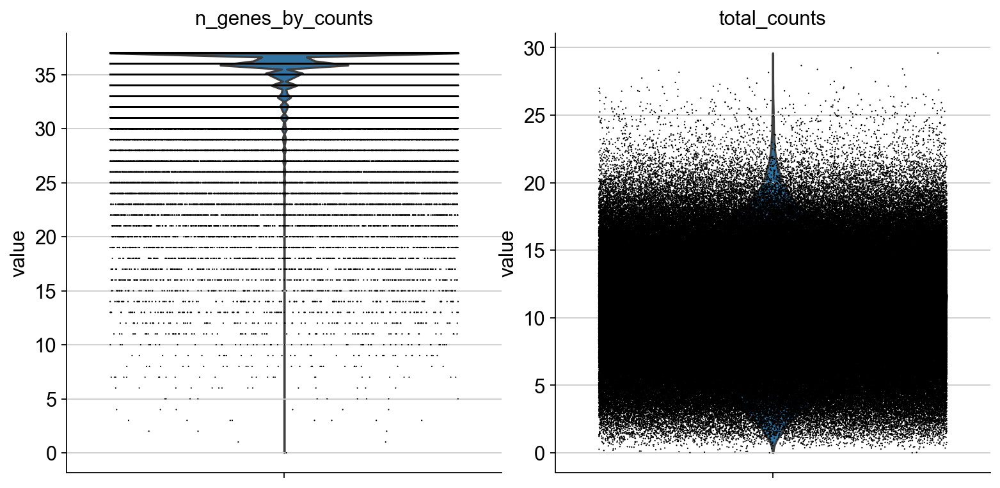

In [16]:
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts'],jitter=0.4, multi_panel=True)

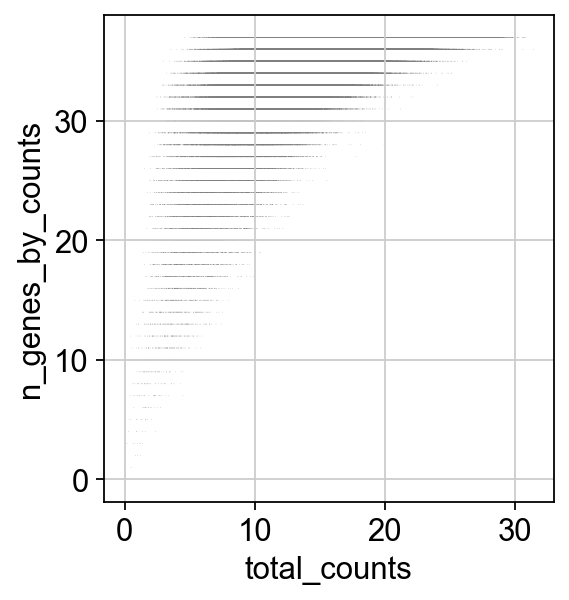

In [17]:
sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts')

In [17]:
#Perform scaling of the data to bring 0 to -1 and standard deviation is 1
scyan.preprocess.scale(adata)

[INFO] (scyan.preprocess) Data will be centered and standardised. This is advised only when using spectral/flow data (if this is not your case, consider running 'asinh_transform' instead of 'auto_logicle_transform').


computing PCA
    with n_comps=36
    finished (0:00:02)


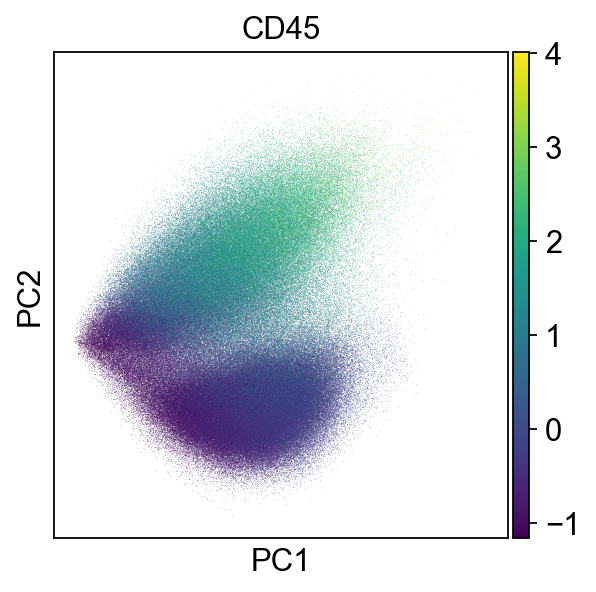

In [19]:
sc.tl.pca(adata, svd_solver='arpack') # peform PCA
sc.pl.pca(adata, color='CD45') # scatter plot in the PCA coordinates 

# Cell annotation with scyan

<img src=https://mics-lab.github.io/scyan/assets/logo.png width="500">

## Importing cell tables with populations

In [20]:
#Importing the model for scyan with relevant cell populations and lineage markers

#Check https://mics-lab.github.io/scyan/advice/ for advice about constructing such cell tables

#Hierarchical cell populations can also be included 
#https://mics-lab.github.io/scyan/tutorials/usage/#working-with-hierarchical-populations

table_phenotype = pd.read_excel(os.path.join(scyan_dir,'scyan_clustering_TG.xlsx'),index_col=[0, 1,2])

In [21]:
table_phenotype

,,,CD4,CD8,CD3e,FoxP3,SMA,CD31,CD45,CD68,CD163,CD7,Vimentin,PanCK,MPO,DCN,CD20,HLADRa,CD14
Population,Level_2,Level_1,,,,,,,,,,,,,,,,,
CD8_Tcells,Lymphoid,Immune,-1,1,1,-1,-1.0,-1,NaN,-1,-1,NaN,NaN,-1.0,-1,-1.0,-1,-1,-1.0
CD4_Tcells,Lymphoid,Immune,1,-1,1,-1,-1.0,-1,NaN,-1,-1,NaN,NaN,-1.0,-1,-1.0,-1,-1,-1.0
Reg_Tcells,Lymphoid,Immune,1,-1,1,1,-1.0,-1,NaN,-1,-1,NaN,NaN,-1.0,-1,-1.0,-1,-1,-1.0
B_cells,Lymphoid,Immune,-1,-1,-1,-1,-1.0,-1,NaN,-1,-1,-1.0,-1.0,-1.0,-1,-1.0,1,1,-1.0
NK_cells,Lymphoid,Immune,-1,-1,-1,-1,-1.0,-1,NaN,-1,-1,1.0,-1.0,-1.0,-1,-1.0,-1,-1,-1.0
Macrophages,Myeloid,Immune,-1,-1,-1,-1,-1.0,-1,NaN,1,-1,-1.0,NaN,-1.0,-1,-1.0,-1,-1,NaN
M2_like_macrophages,Myeloid,Immune,-1,-1,-1,-1,-1.0,-1,NaN,1,1,-1.0,NaN,-1.0,-1,-1.0,-1,-1,NaN
Neutrophils,Myeloid,Immune,-1,-1,-1,-1,-1.0,-1,NaN,-1,-1,-1.0,NaN,-1.0,1,-1.0,-1,-1,NaN
Dendritic_cells,Myeloid,Immune,-1,-1,-1,-1,-1.0,-1,NaN,-1,-1,-1.0,NaN,-1.0,-1,-1.0,-1,1,NaN


In [22]:
table_phenotype.dtypes

CD4           int64
CD8           int64
CD3e          int64
FoxP3         int64
SMA         float64
CD31          int64
CD45        float64
CD68          int64
CD163         int64
CD7         float64
Vimentin    float64
PanCK       float64
MPO           int64
DCN         float64
CD20          int64
HLADRa        int64
CD14        float64
dtype: object

## Plotting UMAPs

In [23]:
# Use only the cell-type markers (recommended), or your choose your own list of markers

scyan.tools.umap(adata, markers=table_phenotype.columns)

[INFO] (scyan.tools.representation) Fitting UMAP...


UMAP(min_dist=0.5, tqdm_kwds={'bar_format': '{desc}: {percentage:3.0f}%| {bar} {n_fmt}/{total_fmt} [{elapsed}]', 'desc': 'Epochs completed', 'disable': True})

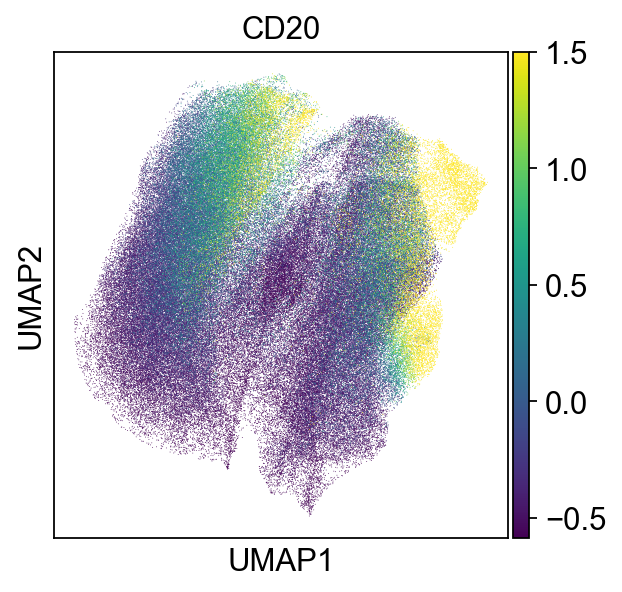

In [28]:
scyan.plot.umap(adata, color=["CD20"])

In [30]:
scyan.tools.umap(adata, markers=channels)

[INFO] (scyan.tools.representation) Fitting UMAP...


UMAP(min_dist=0.5, tqdm_kwds={'bar_format': '{desc}: {percentage:3.0f}%| {bar} {n_fmt}/{total_fmt} [{elapsed}]', 'desc': 'Epochs completed', 'disable': True})

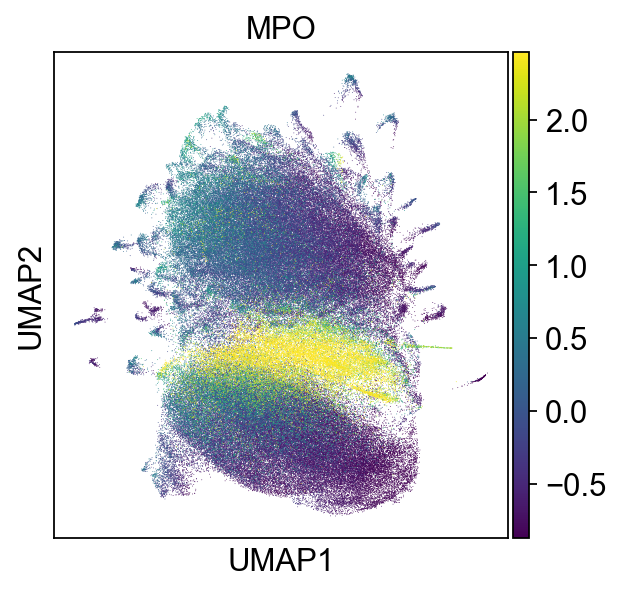

In [32]:
scyan.plot.umap(adata, color=["MPO"])

## Running scyan prediction model

In [29]:
batch_effect_correction = True

if not batch_effect_correction:
    model = scyan.Scyan(adata,table_phenotype,batch_size=5000)
else:
    # When training for the first time on a new dataset, we advise to start with the default arguments (i.e., remove 'prior_std' and 'lr')
    # if there are batch effects, define them in the batch_key argument
    model = scyan.Scyan(adata,table_phenotype,batch_key='fov',  batch_size = 5000)

# For better batch effect correction, we advise to increase the default 'patience' and decrease 'min_delta'
# NB: if you have less than 1 million cells, you can also increase 'max_epochs'
model.fit(patience=10, min_delta=0.1, max_epochs=250)

[INFO] (scyan.model) Initialized Scyan model with N=493940 cells, P=13 populations and M=17 markers.
   ├── Covariates: fov
   ├── No continuum-marker provided
   └── Batch correction mode: True
[INFO] (scyan.model) Training scyan with the following hyperparameters:
"batch_key":       fov
"batch_size":      5000
"hidden_size":     16
"lr":              0.0005
"max_samples":     200000
"modulo_temp":     3
"n_hidden_layers": 6
"n_layers":        7
"prior_std":       0.3
"temperature":     0.5
"warm_up":         (0.35, 4)

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name   | Type        | Params
---------------------------------------
0 | module | ScyanModule | 139 K 
---------------------------------------
139 K     Trainable params
0         Non-trainable params
139 K     Total params
0.557     Total estimated model params size (MB)


Epoch 145: 100%|██████████| 40/40 [00:08<00:00,  4.47it/s, loss=17.6]

[INFO] (scyan.model) Successfully ended training.


Scyan model with N=493940 cells, P=13 populations and M=17 markers.
   ├── Covariates: fov
   ├── No continuum-marker provided
   └── Batch correction mode: True

Model to run in case batch effects are present

In [30]:
model.predict()

DataLoader: 100%|██████████| 99/99 [00:11<00:00,  8.40it/s]


0               NK_cells
1               NK_cells
2           Cancer_cells
3           Cancer_cells
4           Cancer_cells
               ...      
493935       Neutrophils
493936       Fibroblasts
493937    Myofibroblasts
493938      Cancer_cells
493939       Fibroblasts
Length: 493940, dtype: category
Categories (13, object): ['B_cells', 'CD4_Tcells', 'CD8_Tcells', 'Cancer_cells', ..., 'Myofibroblasts', 'NK_cells', 'Neutrophils', 'Reg_Tcells']

In [31]:
model.predict_proba()

DataLoader: 100%|██████████| 99/99 [00:10<00:00,  9.54it/s]


Population,CD8_Tcells,CD4_Tcells,Reg_Tcells,B_cells,NK_cells,Macrophages,M2_like_macrophages,Neutrophils,Dendritic_cells,Cancer_cells,Myofibroblasts,Fibroblasts,Endothelial_cells,max_log_prob,max_log_prob_u
0,2.709639e-20,3.138204e-20,5.671374e-29,4.483591e-27,9.999993e-01,3.022105e-20,1.041629e-30,5.565401e-19,1.259742e-15,6.674549e-07,9.493314e-28,1.650203e-18,2.582882e-21,-4.058203,-0.742112
1,5.541872e-25,4.210473e-25,3.076896e-36,5.088348e-30,1.000000e+00,2.062529e-25,2.490788e-35,1.718768e-21,9.522547e-22,9.557856e-13,4.147700e-30,3.428661e-23,1.080028e-24,-2.504715,0.811376
2,7.577076e-22,7.714807e-20,4.863321e-31,6.416839e-28,2.960516e-07,1.284353e-12,8.680456e-25,3.483251e-16,3.703971e-16,9.999998e-01,1.572733e-24,9.388186e-15,2.543235e-15,-2.782342,-2.028761
3,2.769673e-32,3.675472e-30,9.905779e-42,3.564432e-28,1.610488e-20,1.641269e-20,3.007838e-33,4.911214e-17,1.291545e-14,1.000000e+00,1.289865e-27,1.043641e-18,1.412424e-20,-3.409196,-2.655615
4,1.880936e-26,2.875662e-28,1.910348e-40,1.145047e-35,5.226813e-21,6.163785e-23,6.905489e-36,5.257308e-21,2.120707e-25,1.000000e+00,5.040865e-28,3.660981e-19,1.950706e-20,-1.111496,-0.357915
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
493935,1.397214e-30,1.400022e-28,1.642518e-39,1.577862e-42,4.692336e-27,2.199474e-17,1.953518e-30,1.000000e+00,1.925550e-16,1.175423e-17,2.319234e-28,7.722737e-18,1.921504e-27,-9.651660,-7.128874
493936,7.803558e-26,4.764686e-28,2.093000e-38,9.236441e-38,1.051200e-21,8.291665e-05,5.664580e-19,1.559254e-14,7.940620e-16,2.964747e-10,5.720217e-10,9.999170e-01,6.736640e-11,-8.264728,-6.670985
493937,4.053825e-35,4.932454e-33,2.101948e-44,2.416037e-35,2.473332e-27,2.713706e-23,2.024288e-35,1.653463e-19,2.646564e-19,2.125947e-14,5.929742e-01,3.973610e-01,9.664877e-03,-10.985455,-7.309210
493938,1.022747e-28,3.652411e-22,1.971857e-34,4.587375e-22,3.430792e-13,2.509159e-17,2.934093e-27,4.602969e-14,5.856388e-10,1.000000e+00,3.282157e-20,1.573257e-11,2.158273e-14,-1.623510,-0.869929


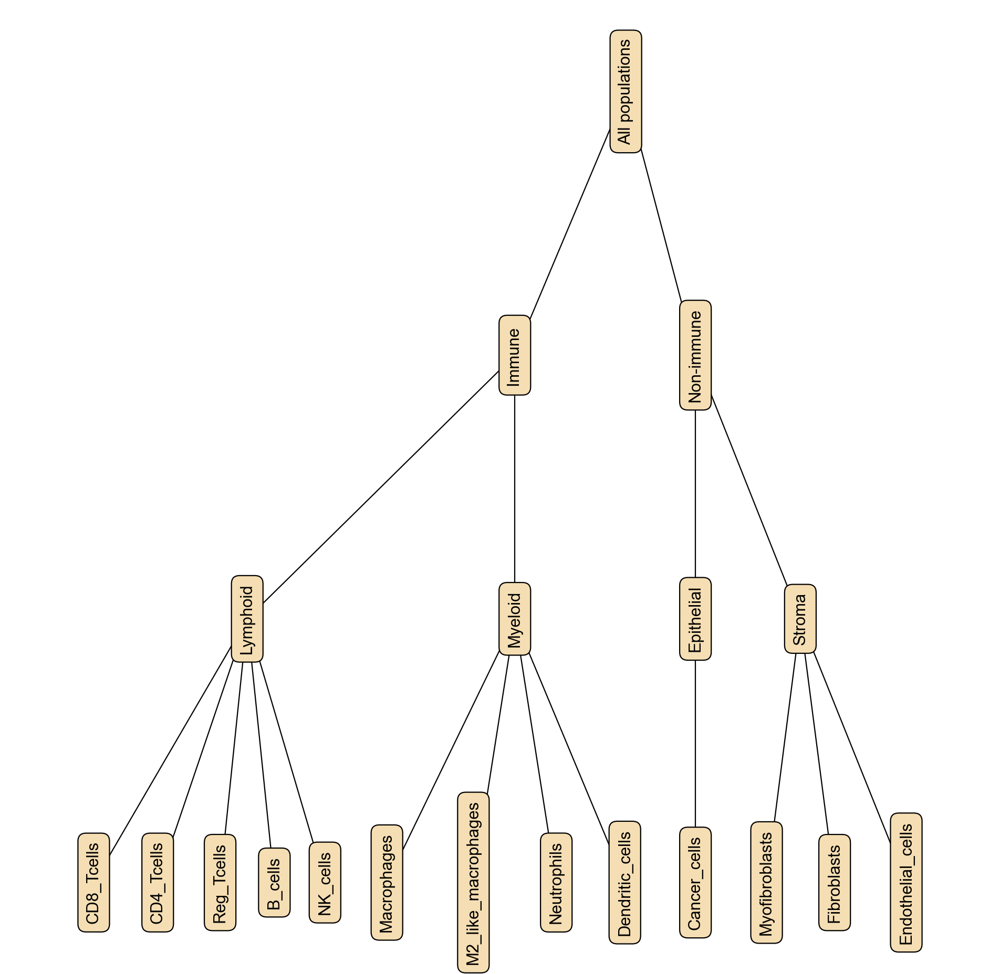

In [32]:
scyan.plot.pops_hierarchy(model, figsize=(15, 15))

In [33]:
adata.obs['scyan_pop'] = adata.obs['scyan_pop'].astype("string")
adata.obs['scyan_pop_Level_1'] = adata.obs['scyan_pop_Level_1'].astype("string")
adata.obs['scyan_pop_Level_2'] = adata.obs['scyan_pop_Level_2'].astype("string")
adata.obs['scyan_pop_Level_2'] = adata.obs['scyan_pop_Level_2'].fillna('Unknown')
adata.obs['scyan_pop_Level_1'] = adata.obs['scyan_pop_Level_1'].fillna('Unknown')
adata.obs['scyan_pop'] = adata.obs['scyan_pop'].fillna('Unknown')


In [34]:
adata.obs['scyan_pop'].value_counts()

scyan_pop
Cancer_cells           210893
Fibroblasts             91901
Neutrophils             39501
CD4_Tcells              27985
NK_cells                24975
Endothelial_cells       24614
Macrophages             19541
CD8_Tcells              19216
Myofibroblasts          15036
Dendritic_cells          9765
Reg_Tcells               6396
M2_like_macrophages      2874
Unknown                   836
B_cells                   407
Name: count, dtype: Int64

DataLoader: 100%|██████████| 40/40 [00:03<00:00, 10.60it/s]


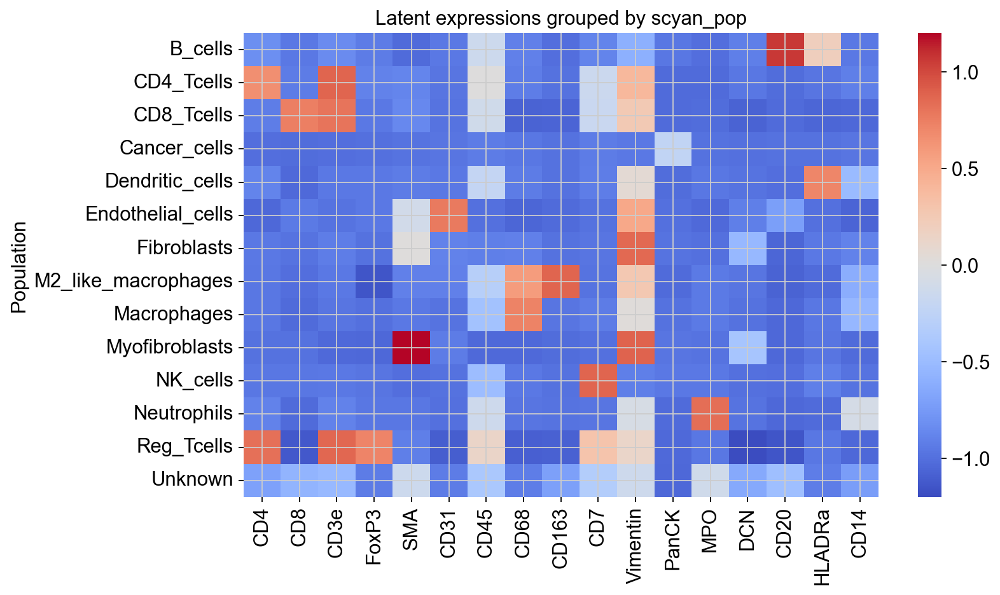

In [35]:
scyan.plot.pops_expressions(model)

OptionError: "No such keys(s): 'mode.use_inf_as_null'"

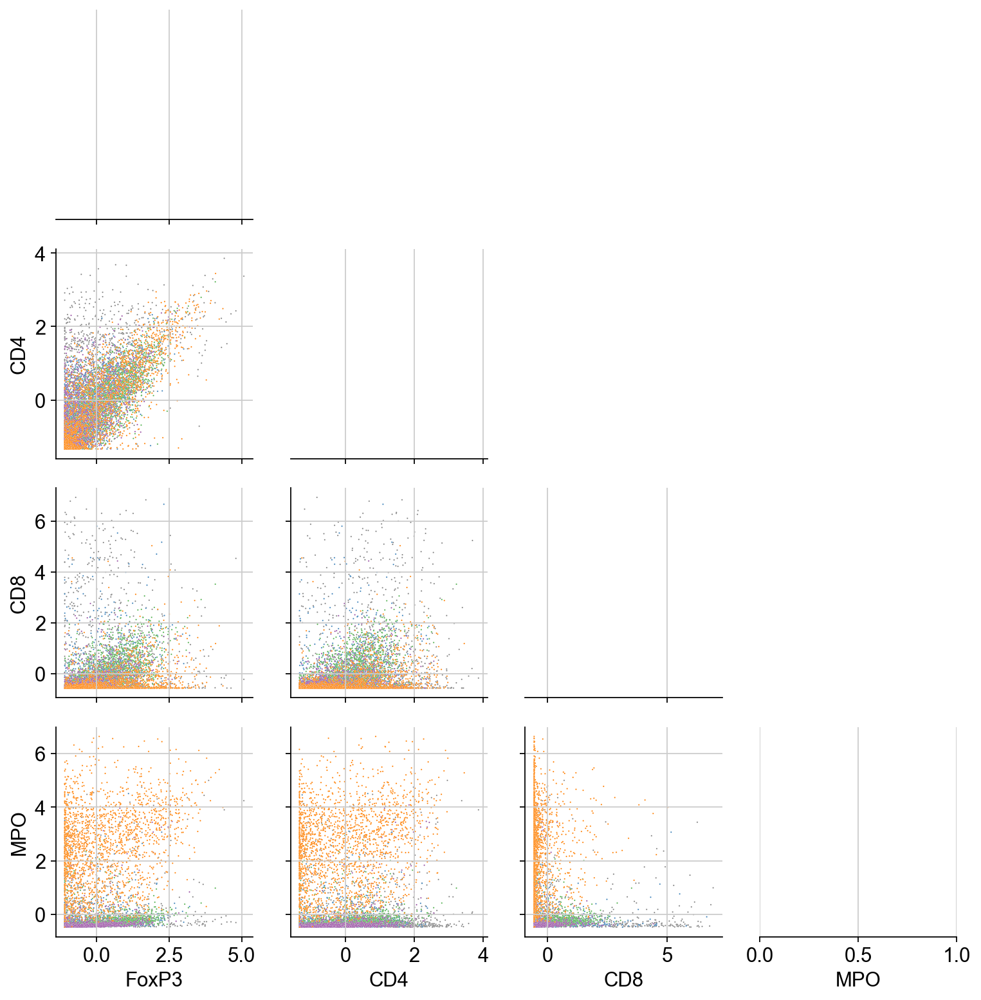

In [36]:
populations = ['Neutrophils', 'Myofibroblasts', 'Cancer_cells','Endothelial_cells']
scyan.plot.scatter(adata, populations,markers=['FoxP3','CD4','CD8','MPO'])

DataLoader: 100%|██████████| 8/8 [00:00<00:00, 12.62it/s]


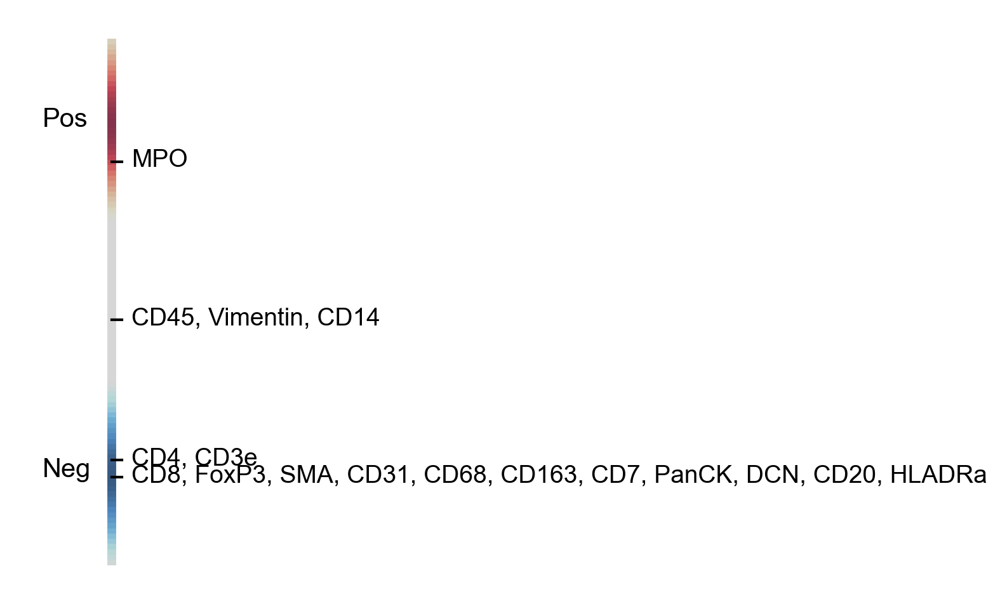

DataLoader: 100%|██████████| 4/4 [00:00<00:00, 22.29it/s]


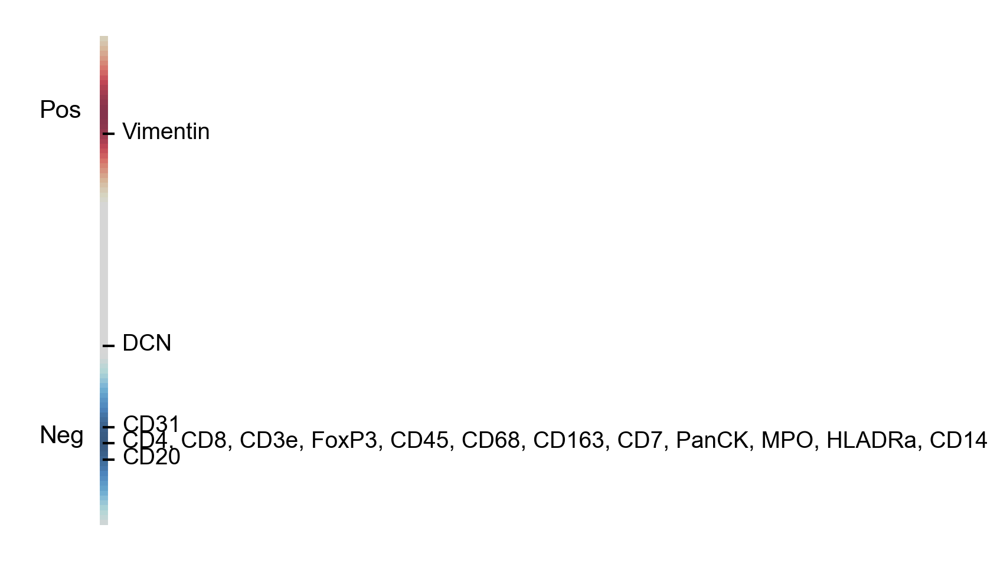

DataLoader: 100%|██████████| 43/43 [00:03<00:00, 14.19it/s]


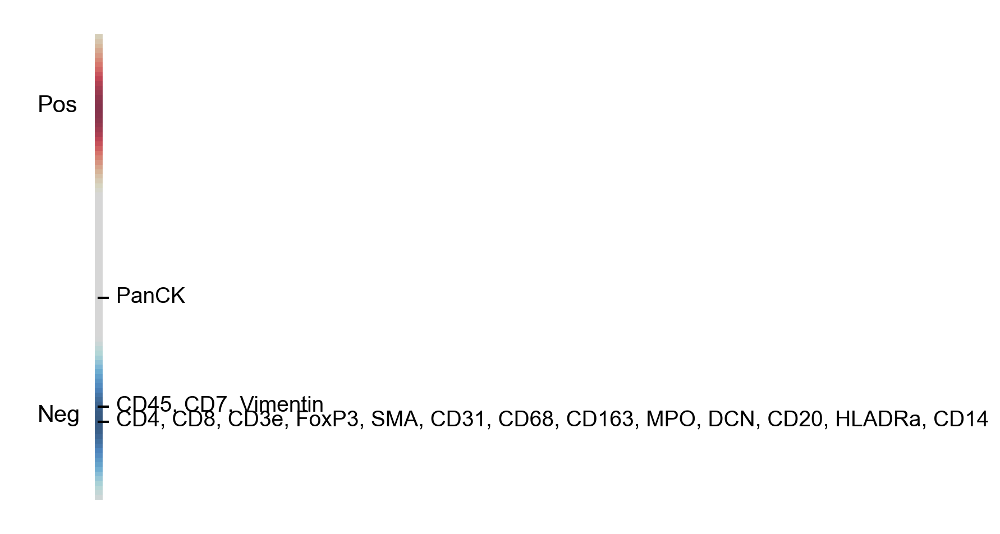

DataLoader: 100%|██████████| 5/5 [00:00<00:00, 17.86it/s]


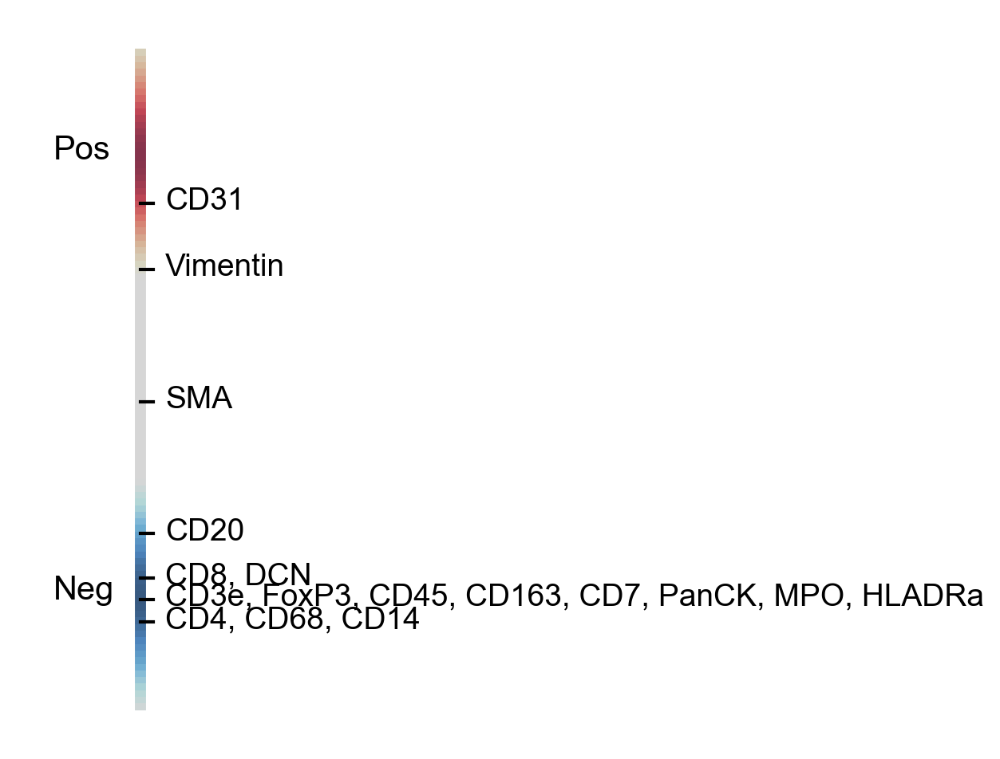

In [37]:
for i in range(0,len(populations)):
    scyan.plot.pop_expressions(model, populations[i])

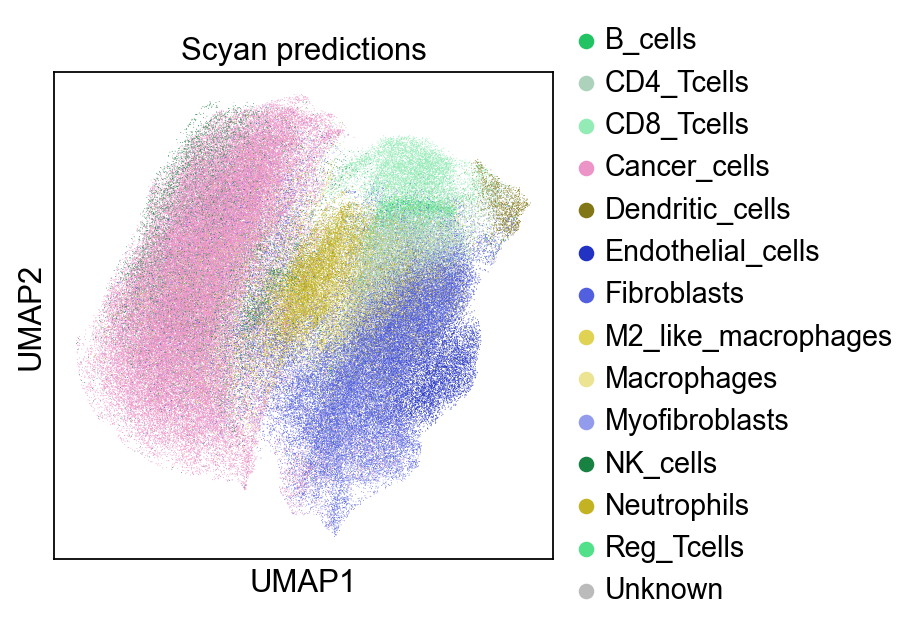

In [38]:
palette = scyan.tools.palette_level(table_phenotype)

palette["Unknown"] = "#bbb" # Only if you renamed the np.nan cells as "Unknown"

ax0 = scyan.plot.umap(adata, color="scyan_pop", title="Scyan predictions", palette = palette)

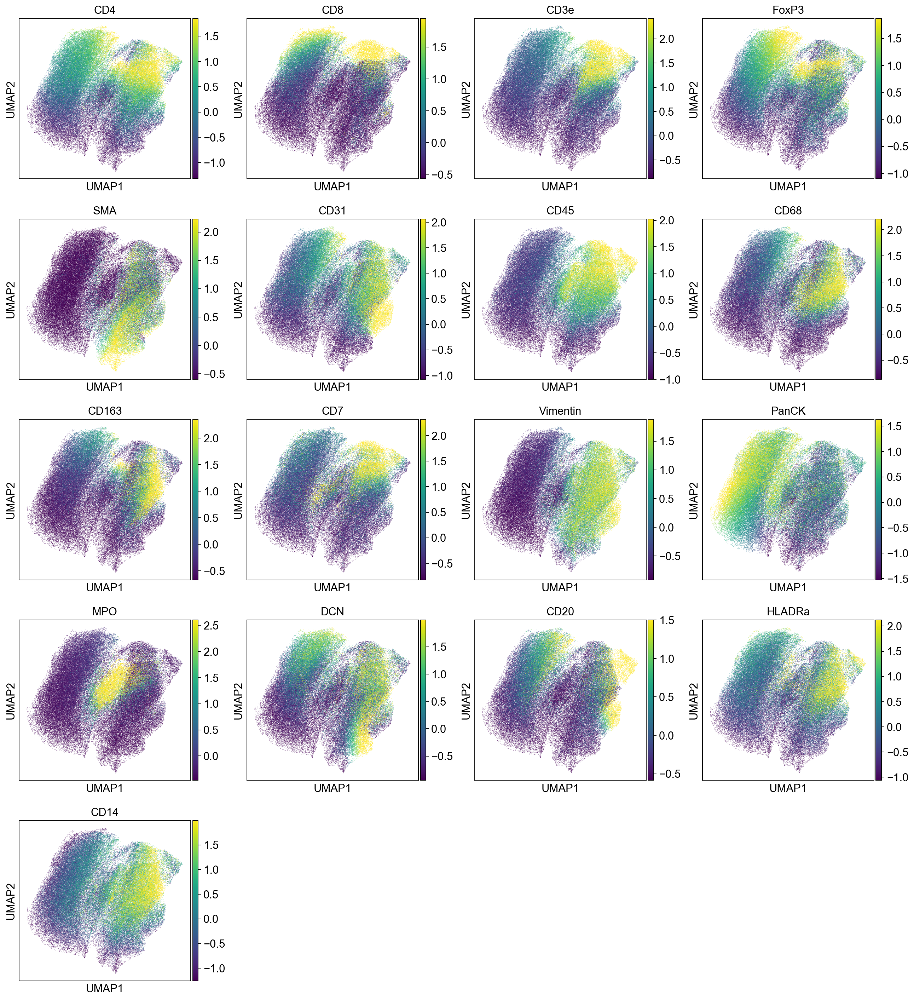

In [39]:
scyan.plot.umap(adata, color = table_phenotype.columns)

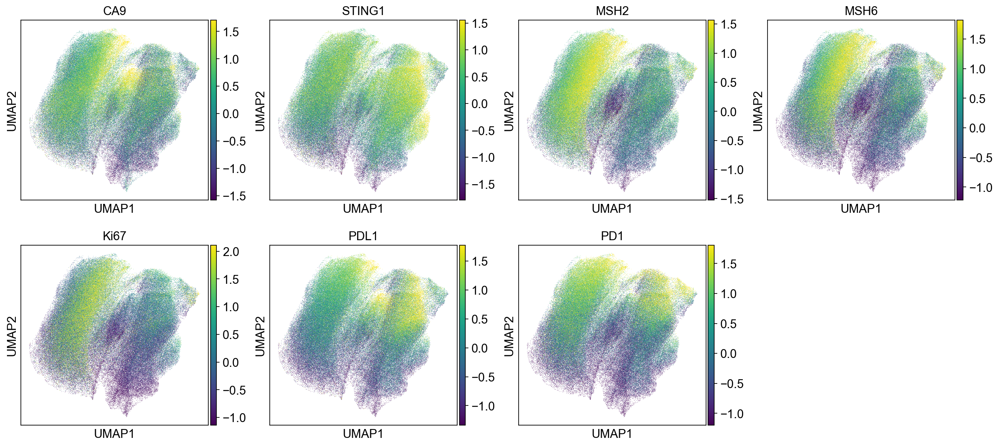

In [41]:
scyan.plot.umap(adata, color = other_channels)

In [42]:
adata.obs['scyan_pop']=adata.obs['scyan_pop'].astype('category')

    using data matrix X directly
Storing dendrogram info using `.uns['dendrogram_scyan_pop']`


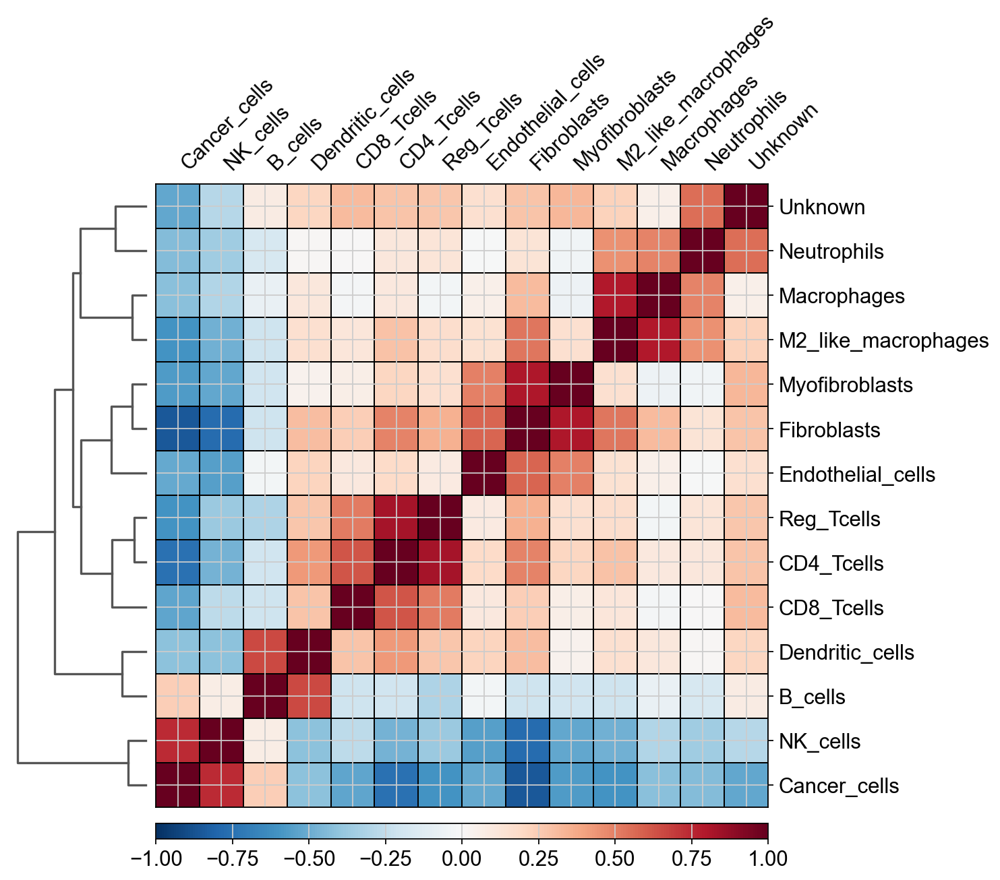

In [43]:
# plot correlation of cell types (default: Pearson)

sc.tl.dendrogram(adata, 'scyan_pop')
ax1 = sc.pl.correlation_matrix(adata, "scyan_pop", figsize=(9,8), cmap = "RdBu_r")

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:01)


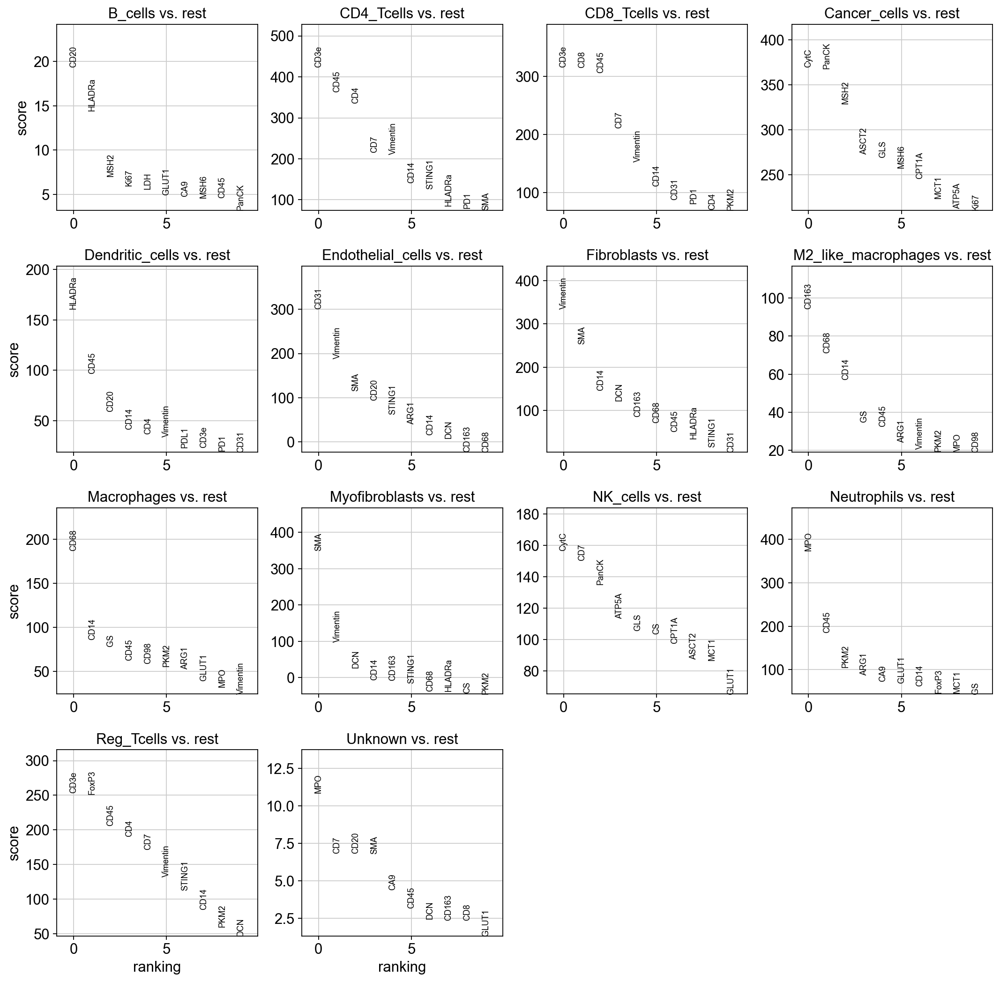

In [44]:
#Identifying marker genes for each population

sc.tl.rank_genes_groups(adata, 'scyan_pop', method='t-test')
sc.pl.rank_genes_groups(adata, n_genes=10, sharey=False)

In [45]:
adata.X = scyan.preprocess.unscale(adata)

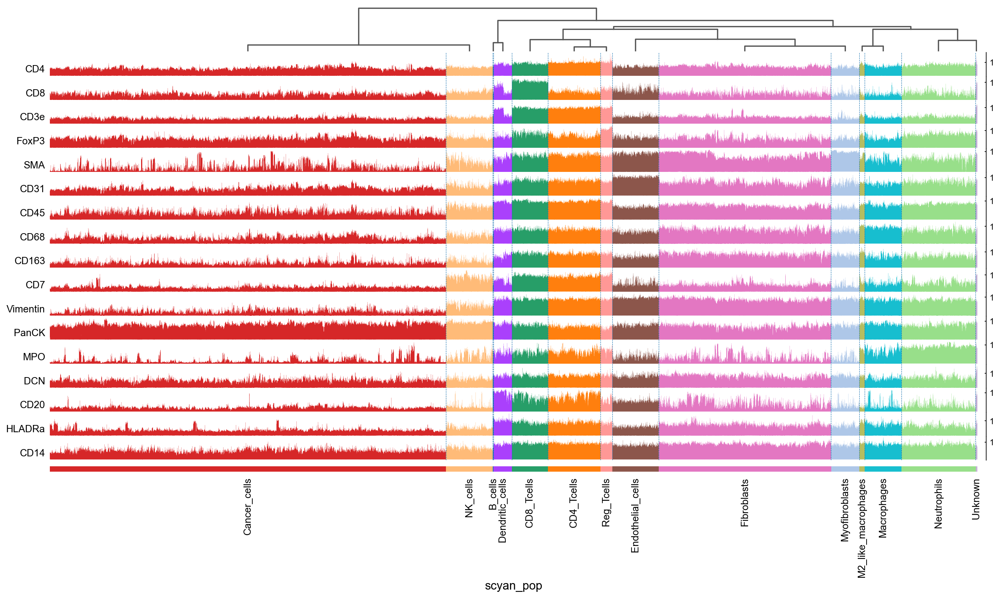

In [46]:
ax = sc.pl.tracksplot(adata, var_names= table_phenotype.columns, groupby='scyan_pop', dendrogram=True,figsize=(20,10))

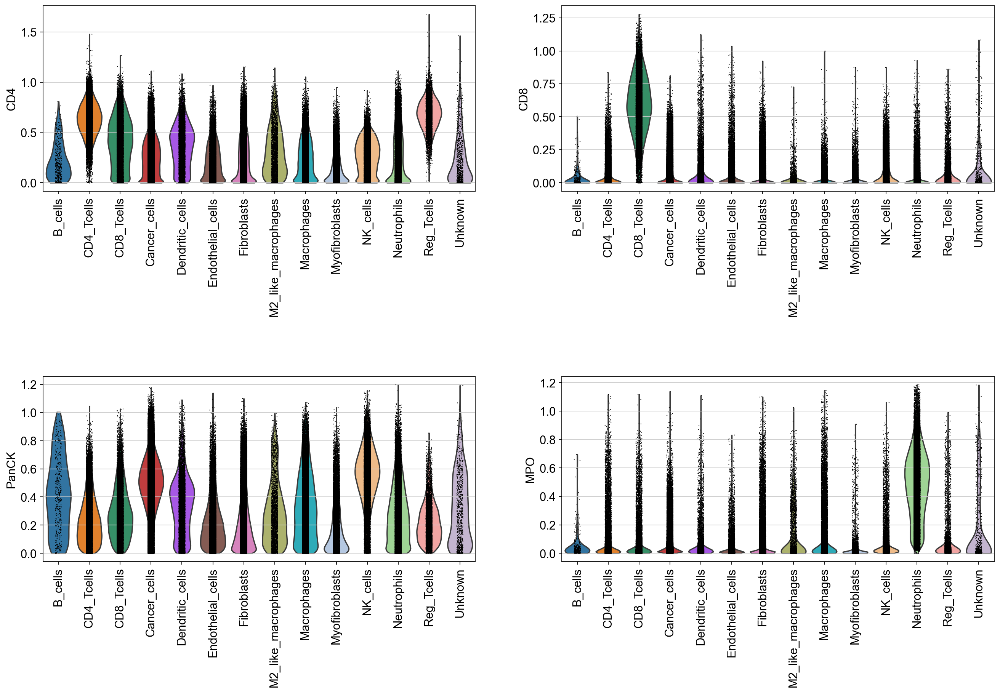

In [47]:
# create violinplots for given markers

violin_marker = ["CD4", "CD8", "PanCK", "MPO"]

fig, axs = plt.subplots(nrows=2, ncols= 2, figsize = (20,12), gridspec_kw={'hspace':1})

ax1_dict = sc.pl.violin(adata, violin_marker[0], groupby='scyan_pop', ax=axs[0,0], show=False, rotation=90)
ax2_dict = sc.pl.violin(adata, violin_marker[1], groupby='scyan_pop', ax=axs[0,1], show=False, rotation=90)
ax3_dict = sc.pl.violin(adata, violin_marker[2], groupby='scyan_pop', ax=axs[1,0], show=False, rotation=90)
ax4_dict = sc.pl.violin(adata, violin_marker[3], groupby='scyan_pop', ax=axs[1,1], show=False, rotation=90)

    using data matrix X directly
Storing dendrogram info using `.uns['dendrogram_scyan_pop_Level_1']`


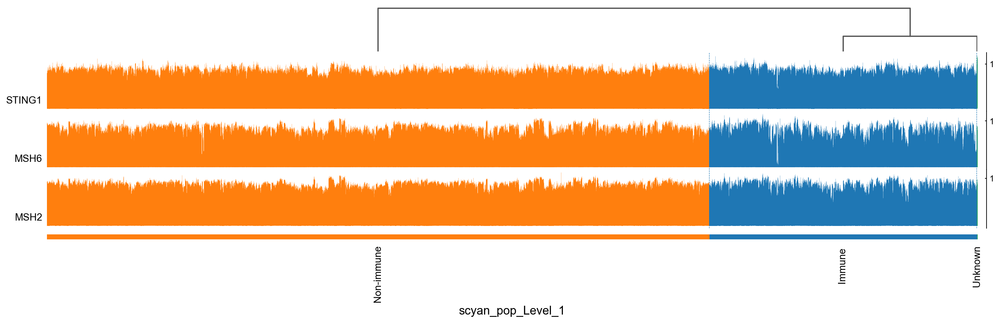

In [43]:
ax = sc.pl.tracksplot(adata, var_names = ['STING1', 'MSH6', 'MSH2'], groupby='scyan_pop_Level_1', dendrogram=True,figsize=(20,5))

## Metabolic scores

In [44]:
data_all = pd.DataFrame(adata.X,columns=adata.var_names)

In [47]:
data_all = data_all.assign(Glycolysis_scMEP = np.mean(data_all[['GLUT1', 'PKM2']], axis=1) - 0)
data_all = data_all.assign(Fermentation_scMEP = np.mean(data_all[['LDH', 'MCT1']], axis=1) - 0)
data_all = data_all.assign(Respiration_scMEP = np.mean(data_all[['CS', 'CytC', 'ATP5A']], axis=1) - 0)
data_all = data_all.assign(AA_scMEP = np.mean(data_all[['GLS','ASCT2', 'CD98', 'GS']], axis=1) - 0)
data_all = data_all.assign(FAO_scMEP = np.mean(data_all[['CPT1A']], axis=1) - 0)

In [50]:
data_all[metabolism].head()

,Glycolysis_scMEP,Fermentation_scMEP,Respiration_scMEP,AA_scMEP,FAO_scMEP
0,0.263048,0.140928,0.425237,0.372817,0.790493
1,0.185983,0.084046,0.495755,0.333534,0.754627
2,0.440712,0.336068,0.530647,0.474044,0.797250
3,0.299955,0.238702,0.398281,0.406245,0.779912
4,0.219624,0.218027,0.415308,0.374015,0.818884


In [51]:
data_all.set_index(adata.obs.index,inplace=True)

In [52]:
adata.obs[metabolism] = data_all[metabolism]

KeyError: nan

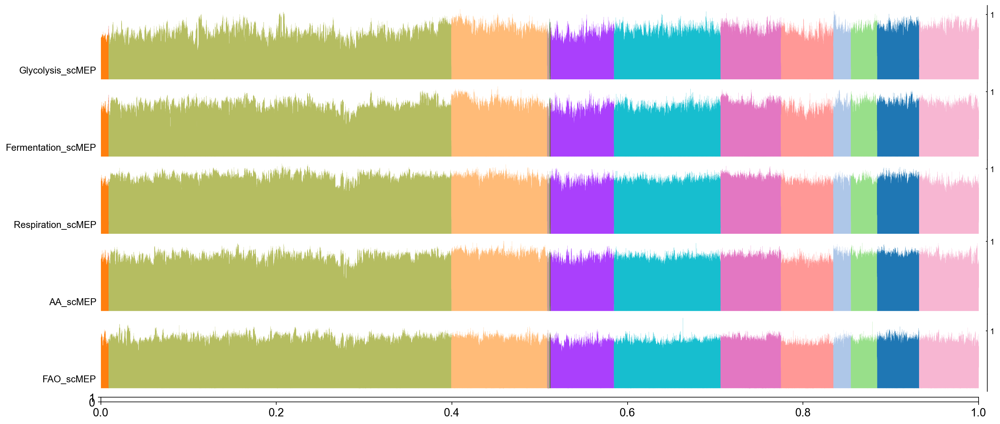

In [53]:
ax = sc.pl.tracksplot(adata, var_names = metabolism, groupby='scyan_pop', dendrogram=True,figsize=(20,10))

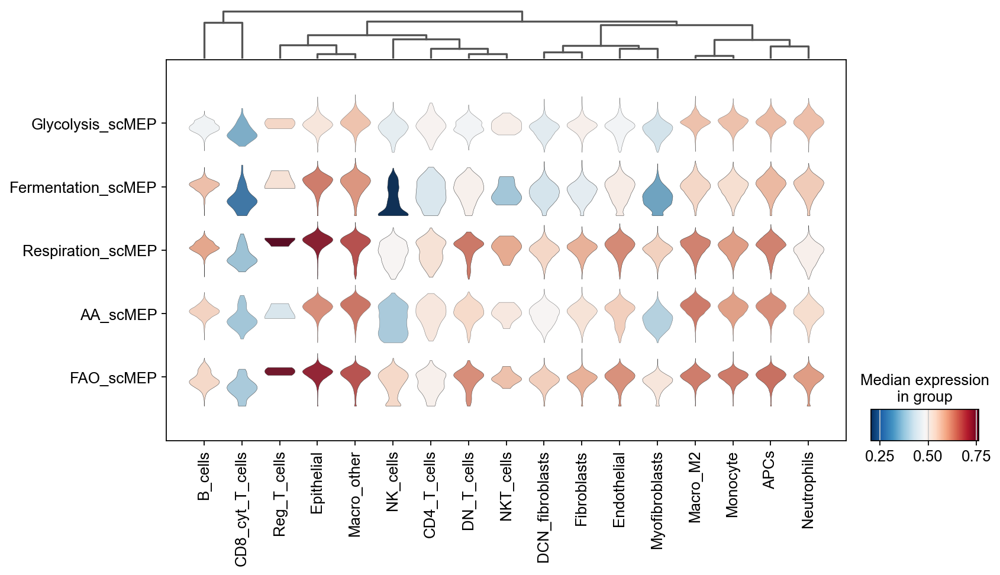

In [54]:
# Visualize heatmap of cell types
ax = sc.pl.stacked_violin(adata, 
                          metabolism,
                          groupby='scyan_pop',
                          layer='scaled',
                          #vmin=0,
                          #vmax=0.5,
                          cmap='RdBu_r',
                          dendrogram=True,
                          swap_axes=True,
                          figsize=(11,6))

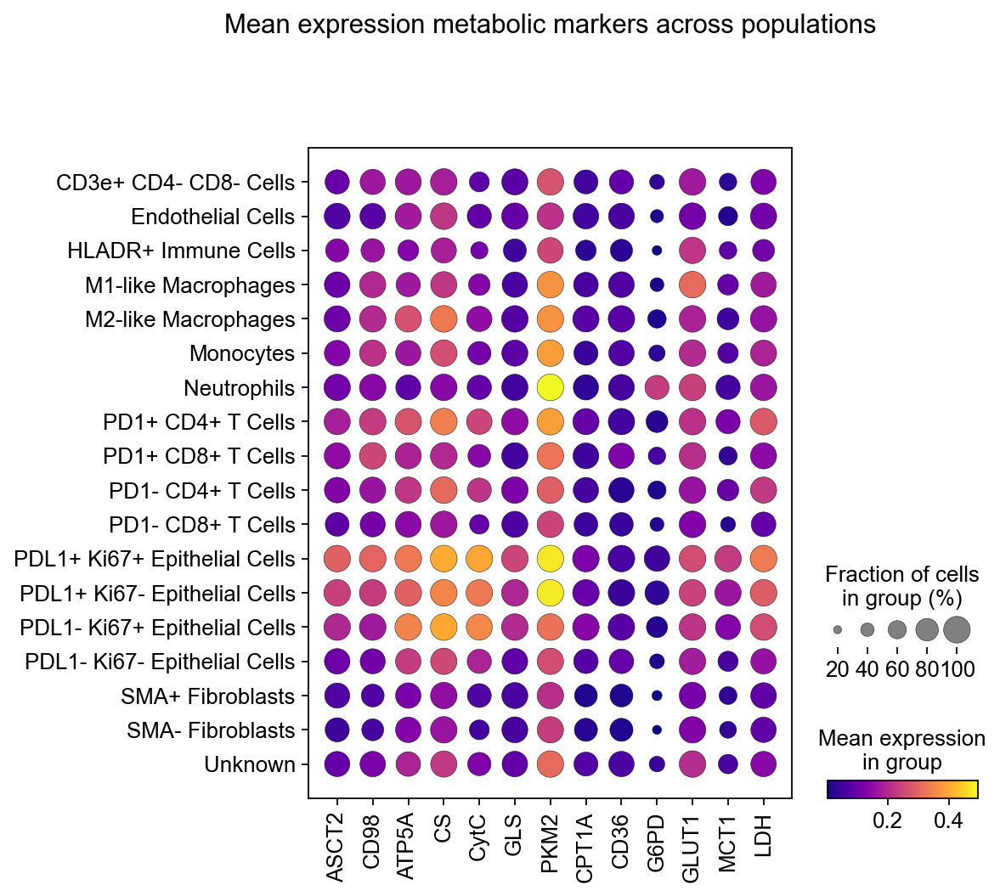

In [ ]:
# create dotplot to see mean expression across cell types

ax = sc.pl.dotplot(adata, 
                   var_names = meta, 
                   title = "Mean expression metabolic markers across populations", 
                   groupby="scyan_pop", 
                   cmap = "plasma", 
                   #vmin=0,
                   #vmax=0.5,
                   show=False)

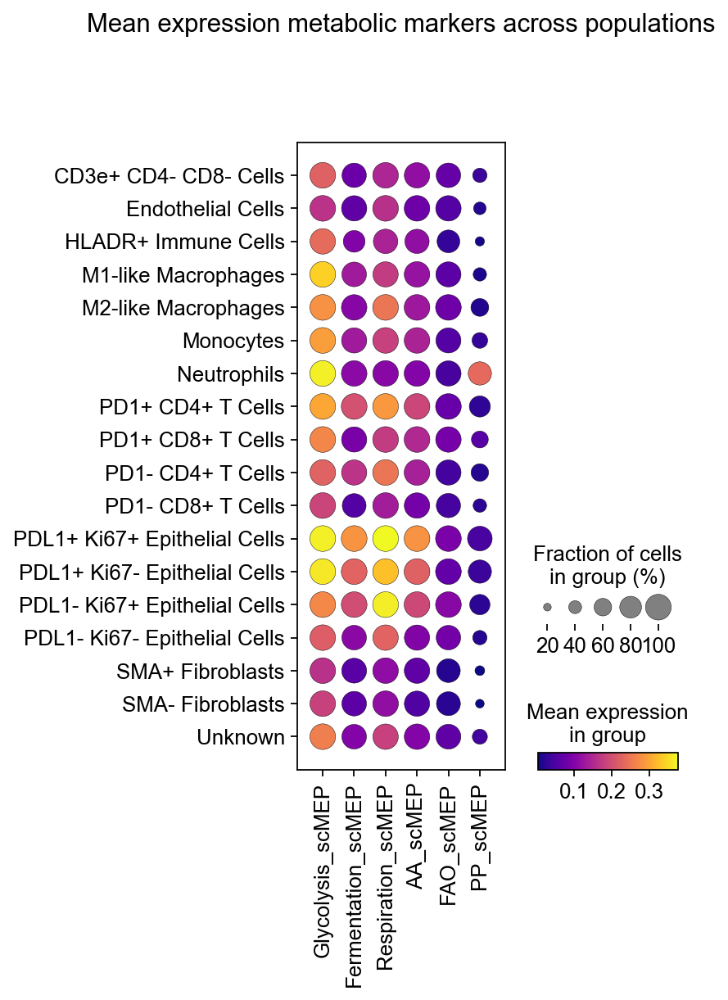

In [ ]:
ax = sc.pl.dotplot(adata, 
                   var_names = metabolism,
                   title = "Mean expression metabolic markers across populations",
                   groupby="scyan_pop",
                   cmap = "plasma",
                   #vmin=0,
                   #vmax=0.3,
                   show=False)

In [ ]:
# write anndata to disk

adata.write_loom("MIBI_data_analysis.loom",write_obsm_varm=True)

# Analysis of CA9 expression in tissues

In [43]:
adata = sc.read_loom('MIBI_data_analysis.loom', sparse=False, var_names="var_names")

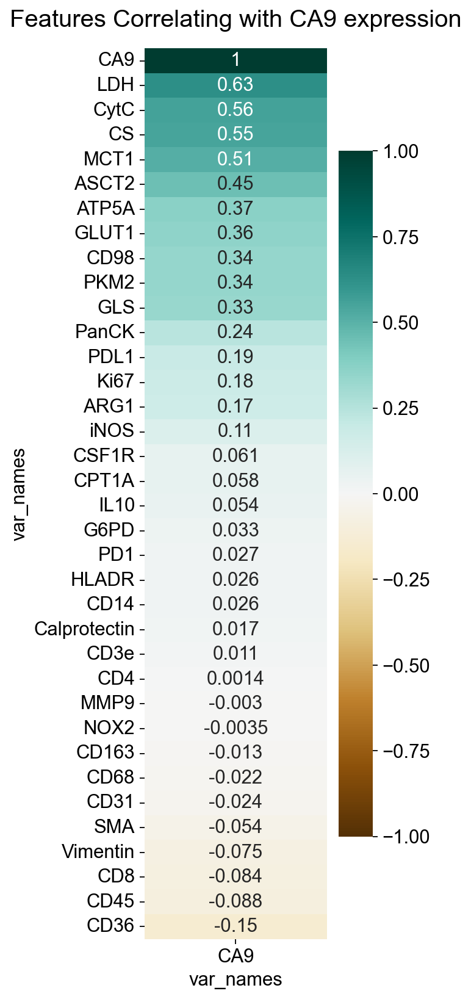

In [ ]:
plt.figure(figsize=(3,12))

dataframe = pd.DataFrame(adata.X,columns=adata.var_names)

# Set the range of values to be displayed on the colormap from -1 to 1, and set the annotation to True to display the correlation values on the heatmap.
heatmap = sns.heatmap(dataframe.corr()[['CA9']].sort_values(by='CA9', ascending=False), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Features Correlating with CA9 expression', fontdict={'fontsize':18}, pad=16);

In [ ]:
data = pd.concat([adata.to_df(), adata.obs], axis=1)
data['scyan_pop'] = data.scyan_pop.astype(str)

In [ ]:
data['CA9'].quantile(0.9)

0.4158520221710206

In [ ]:
data['CA9 State'] = data['CA9'].map(lambda x: 'CA9+' if x > data['CA9'].quantile(0.9) else 'CA9-')

adata.obs['CA9 State'] = data['CA9 State']

data_1 = adata.obs

data_1['phenotype'] = data_1.apply(lambda row: row['scyan_pop_Fine Level'] + ' ' + row['CA9 State']
                            if row['scyan_pop_Fine Level'] == 'Epithelial Cells'
                            else row['scyan_pop'], axis=1)

adata.obs['phenotype'] = data_1['phenotype']

In [ ]:
data.value_counts(["scyan_pop_Fine Level", "CA9 State"])

scyan_pop_Fine Level  CA9 State
Epithelial Cells      CA9-         28764
Myeloid               CA9-          8777
Lymphoid              CA9-          5084
Epithelial Cells      CA9+          4072
Fibroblasts           CA9-          3929
Endothelial Cells     CA9-          1765
Other Immune          CA9-          1367
Myeloid               CA9+           642
Lymphoid              CA9+           450
Unknown               CA9-           272
Fibroblasts           CA9+           219
Other Immune          CA9+            91
Endothelial Cells     CA9+            48
Unknown               CA9+            29
dtype: int64

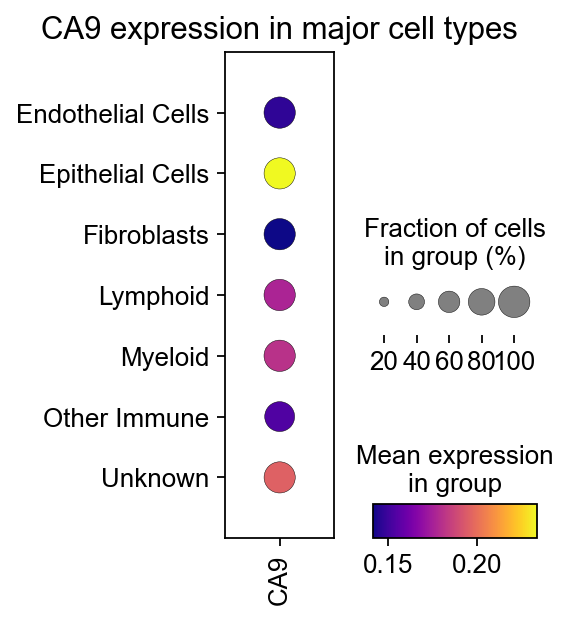

In [ ]:
ax = sc.pl.dotplot(adata, 
                   var_names = 'CA9',
                   title = "CA9 expression in major cell types",
                   groupby="scyan_pop_Fine Level",
                   cmap = "plasma",
                   figsize=(2.5,4))

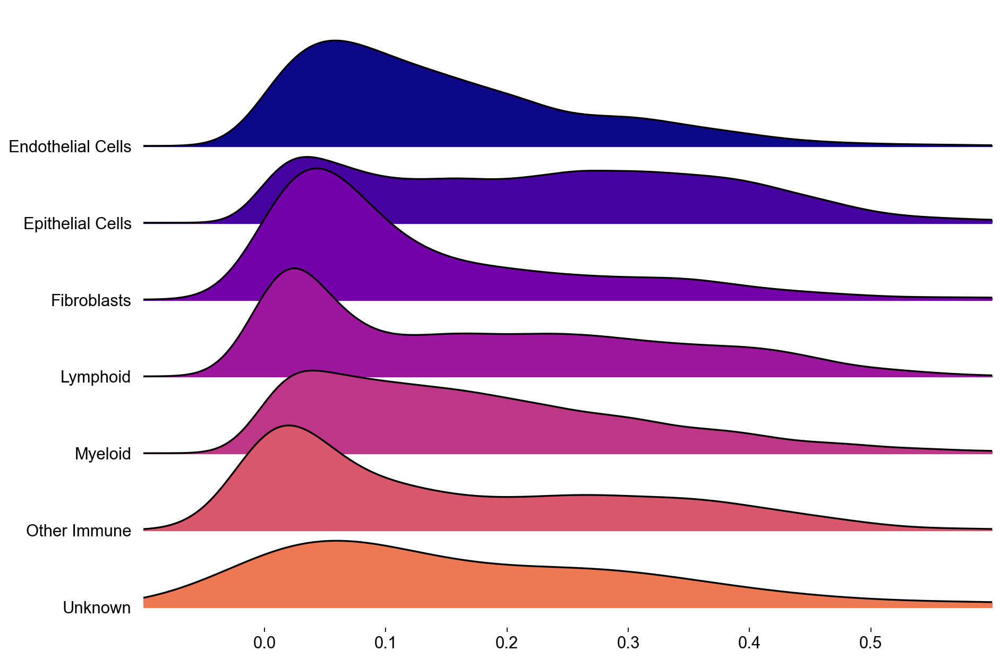

In [ ]:
ax = joyplot(
    data=data, 
    by='scyan_pop_Fine Level',
    column = "CA9",
    figsize=(12, 8),
    color=mcp.gen_color(cmap="plasma",n=10),
    x_range= (-0.1,0.6)
)

In [ ]:
#populations = ["Ki67- Epithelial Cells","Ki67+ Epithelial Cells"]
populations = data['scyan_pop_Fine Level'].unique()

pairs = list(combinations(populations, r=2))
pairs

[('Epithelial Cells', 'Other Immune'),
 ('Epithelial Cells', 'Unknown'),
 ('Epithelial Cells', 'Lymphoid'),
 ('Epithelial Cells', 'Endothelial Cells'),
 ('Epithelial Cells', 'Myeloid'),
 ('Epithelial Cells', 'Fibroblasts'),
 ('Other Immune', 'Unknown'),
 ('Other Immune', 'Lymphoid'),
 ('Other Immune', 'Endothelial Cells'),
 ('Other Immune', 'Myeloid'),
 ('Other Immune', 'Fibroblasts'),
 ('Unknown', 'Lymphoid'),
 ('Unknown', 'Endothelial Cells'),
 ('Unknown', 'Myeloid'),
 ('Unknown', 'Fibroblasts'),
 ('Lymphoid', 'Endothelial Cells'),
 ('Lymphoid', 'Myeloid'),
 ('Lymphoid', 'Fibroblasts'),
 ('Endothelial Cells', 'Myeloid'),
 ('Endothelial Cells', 'Fibroblasts'),
 ('Myeloid', 'Fibroblasts')]

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

Epithelial Cells vs. Other Immune: t-test independent samples with Bonferroni correction, P_val:4.443e-77 t=1.873e+01
Epithelial Cells vs. Unknown: t-test independent samples with Bonferroni correction, P_val:2.600e-04 t=4.090e+00
Epithelial Cells vs. Lymphoid: t-test independent samples with Bonferroni correction, P_val:5.586e-133 t=2.471e+01
Epithelial Cells vs. Endothelial Cells: t-test independent samples with Bonferroni correction, P_val:1.500e-112 t=2.271e+01
Epithelial Cells vs. Myeloid: t-test independent samples with Bonferroni correction, P_val:2.494e-180 t=2.884e+01
Epithelial Cells vs. Fibroblasts: t-test independent samples with Bonferroni correction, P_val:8.330e-263 t=3.497e+01


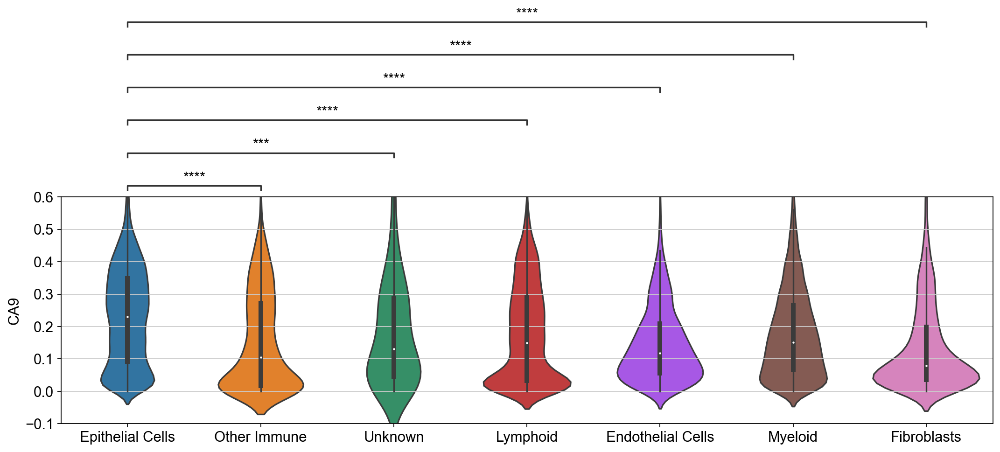

In [ ]:
plt.figure(figsize=(16,4))

#data = data[data['scyan_pop_Fine Level'] == 'Epithelial Cells']

x = 'scyan_pop_Fine Level'
y = "CA9"
pairs = [('Epithelial Cells', 'Lymphoid'),
 ('Epithelial Cells', 'Myeloid'),
 ('Epithelial Cells', 'Unknown'),
 ('Epithelial Cells', 'Endothelial Cells'),
 ('Epithelial Cells', 'Other Immune'),
 ('Epithelial Cells', 'Fibroblasts')]

ax = sns.violinplot(
   data=data, x=x, y = y, order = populations
)

ax.set_ylim(-0.1,0.6)

annotator = Annotator(ax=ax, pairs=pairs, data=data, x=x, y=y, order=populations)
annotator.configure(test='t-test_ind', text_format='star', loc='outside', verbose=2)
annotator.configure(comparisons_correction="Bonferroni", verbose=2)
test_results = annotator.apply_test().annotate()

plt.xlabel('')
plt.show()

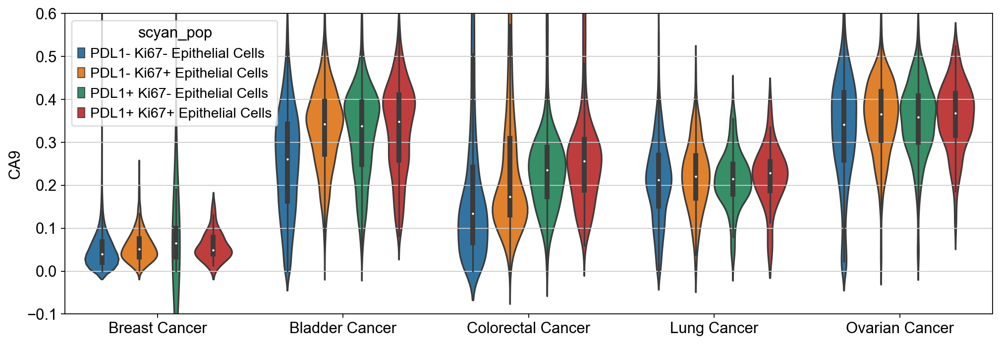

In [ ]:
plt.figure(figsize=(15,5))

data_super_fine = data[data['scyan_pop_Fine Level'] == 'Epithelial Cells']

x = 'Tissue'
y = "CA9"

ax = sns.violinplot(
   data=data_super_fine, x=x, y = y, hue="scyan_pop", split=False
)

ax.set_ylim(-0.1,0.6)

plt.xlabel('')
plt.show()

In [ ]:
populations = ["PDL1- Ki67- Epithelial Cells",
               "PDL1- Ki67+ Epithelial Cells",
               "PDL1+ Ki67- Epithelial Cells",
               "PDL1+ Ki67+ Epithelial Cells"]

pairs = list(combinations(populations, r=2))
pairs

[('PDL1- Ki67- Epithelial Cells', 'PDL1- Ki67+ Epithelial Cells'),
 ('PDL1- Ki67- Epithelial Cells', 'PDL1+ Ki67- Epithelial Cells'),
 ('PDL1- Ki67- Epithelial Cells', 'PDL1+ Ki67+ Epithelial Cells'),
 ('PDL1- Ki67+ Epithelial Cells', 'PDL1+ Ki67- Epithelial Cells'),
 ('PDL1- Ki67+ Epithelial Cells', 'PDL1+ Ki67+ Epithelial Cells'),
 ('PDL1+ Ki67- Epithelial Cells', 'PDL1+ Ki67+ Epithelial Cells')]

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

PDL1- Ki67- Epithelial Cells vs. PDL1- Ki67+ Epithelial Cells: t-test independent samples with Bonferroni correction, P_val:3.703e-151 t=-2.642e+01
PDL1- Ki67+ Epithelial Cells vs. PDL1+ Ki67- Epithelial Cells: t-test independent samples with Bonferroni correction, P_val:5.613e-01 t=-1.677e+00
PDL1+ Ki67- Epithelial Cells vs. PDL1+ Ki67+ Epithelial Cells: t-test independent samples with Bonferroni correction, P_val:1.082e-06 t=-5.225e+00
PDL1- Ki67- Epithelial Cells vs. PDL1+ Ki67- Epithelial Cells: t-test independent samples with Bonferroni correction, P_val:2.845e-133 t=-2.478e+01
PDL1- Ki67+ Epithelial Cells vs. PDL1+ Ki67+ Epithelial Cells: t-test independent samples with Bonferroni correction, P_val:1.866e-10 t=-6.652e+00
PDL1- Ki67- Epithelial Cells vs. PDL1+ Ki67+ Epithelial Cells: t-test independent 

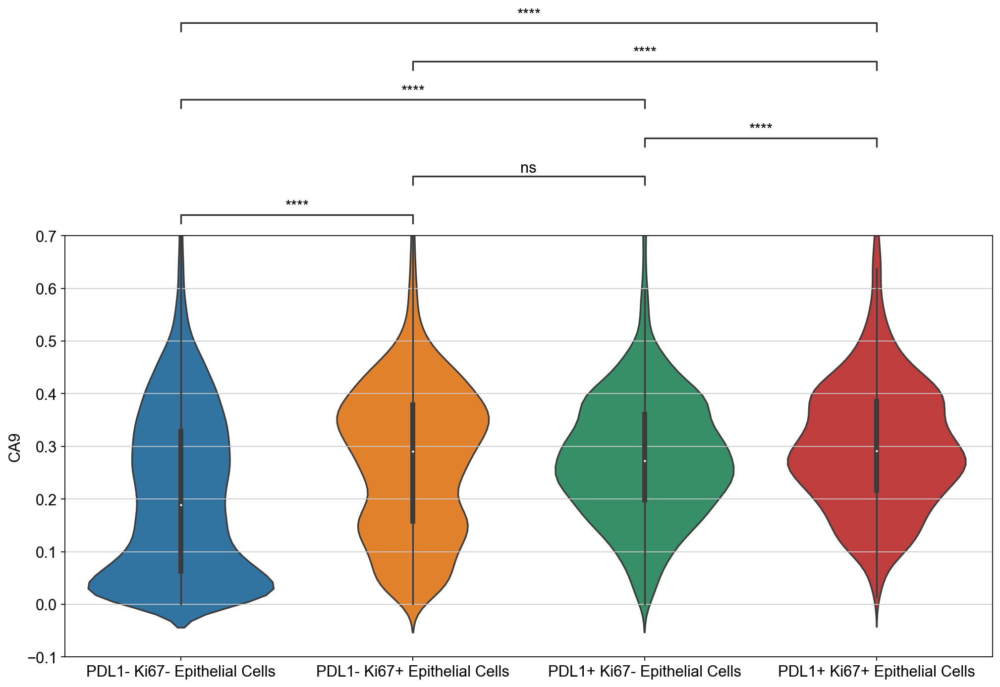

In [ ]:
plt.figure(figsize=(15,7))

data_super_fine = data[data['scyan_pop_Fine Level'] == 'Epithelial Cells']

x = 'scyan_pop'
y = "CA9"

ax = sns.violinplot(
   data=data_super_fine, x=x, y = y, order = populations
)

ax.set_ylim(-0.1,0.7)

annotator.reset_configuration()
annotator = Annotator(ax=ax, pairs=pairs, data=data_super_fine, x=x, y=y, order=populations)
annotator.configure(test="t-test_ind", text_format='star', loc='outside')
annotator.configure(comparisons_correction="Bonferroni", verbose=2)
annotator.apply_and_annotate()

plt.xlabel('')
plt.show()

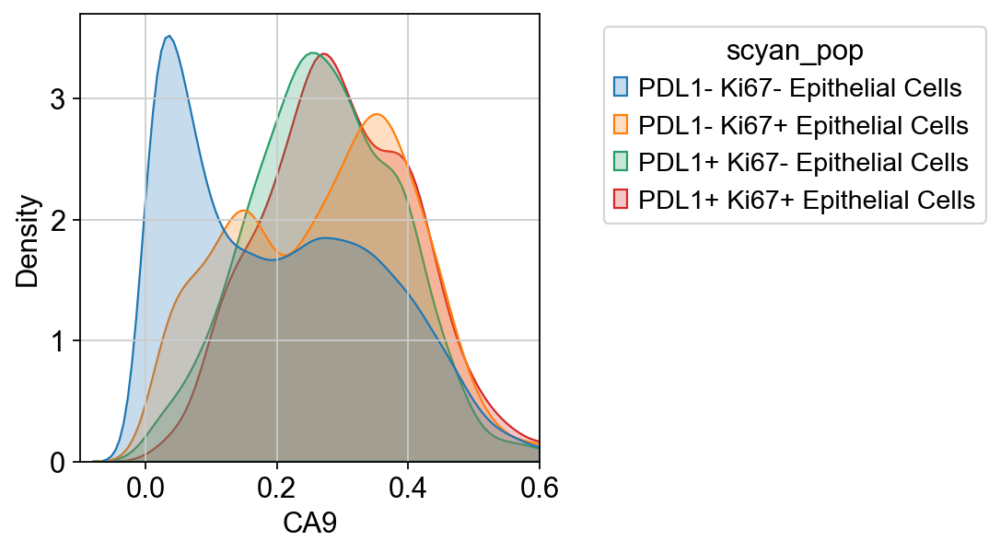

In [ ]:
ax = sns.kdeplot(
    data=data_super_fine,
    x="CA9",
    hue = 'scyan_pop',
    fill=True,
    common_norm=False,
    legend=True
)

sns.move_legend(ax,'upper right', bbox_to_anchor=(1, 0, 1, 1))
ax.set_xlim(-0.1,0.6)

plt.show()

In [ ]:
data_super_fine_correlation = data_super_fine[metabolism+['CA9','PDL1','Ki67']]

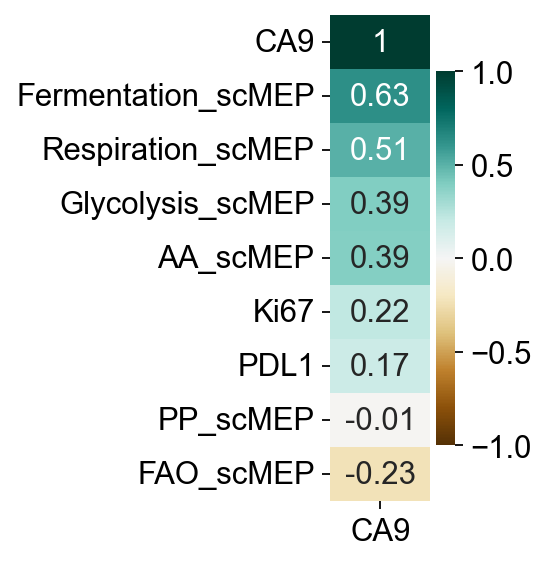

In [ ]:
plt.figure(figsize=(1,4))

heatmap = sns.heatmap(data_super_fine_correlation.corr()[['CA9']].sort_values(by='CA9', ascending=False), vmin=-1, vmax=1, annot=True, cmap='BrBG')

# get the p value for pearson coefficient, subtract 1 on the diagonal
pvals = data_super_fine_correlation.corr(method=lambda x, y: pearsonr(x, y)[1]) - np.eye(*data_super_fine_correlation.corr().shape)
# set the significance threshold
psig = 0.05

#sns.heatmap(data_super_fine_correlation.corr()[pvals<psig][['CA9']].sort_values(by='CA9', ascending=False),  vmin=-1, vmax=1, annot=True, cmap='BrBG')

# Macrophage heterogeneity and metabolic states in tissues

In [52]:
adata = sc.read_loom('MIBI_data_analysis.loom', sparse=False, var_names="var_names")

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


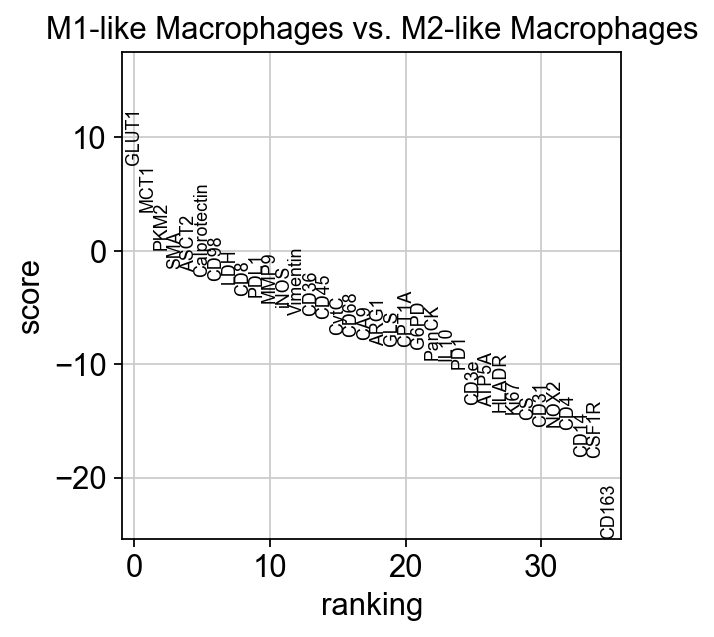

In [53]:
sc.tl.rank_genes_groups(adata, 'scyan_pop', groups=['M1-like Macrophages'], reference='M2-like Macrophages', method='wilcoxon')
sc.pl.rank_genes_groups(adata, groups=['M1-like Macrophages'], n_genes=36)

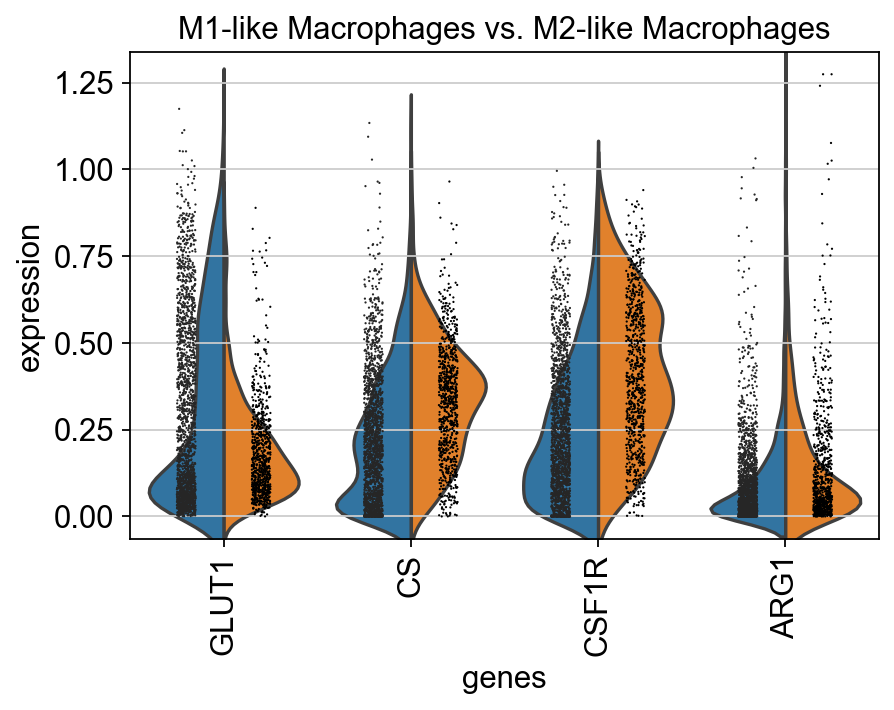

In [54]:
plt.figure(figsize=(6,4))

ax = sc.pl.rank_genes_groups_violin(adata, 
                                    groups='M1-like Macrophages',
                                    gene_names=['GLUT1','CS','CSF1R','ARG1'],
                                   )

In [58]:
data = pd.concat([adata.to_df(), adata.obs], axis=1)
data['scyan_pop'] = data.scyan_pop.astype(str)

In [59]:
Macrophages = data[data['scyan_pop'].isin(['M1-like Macrophages', 'M2-like Macrophages'])]

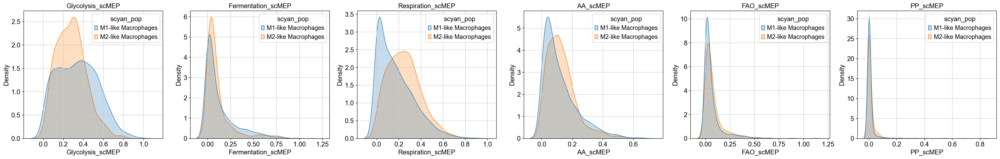

In [60]:
fig, axes = plt.subplots(1,len(metabolism), figsize=(5*len(metabolism),5))

for i in range(0,len(metabolism)):
    ax = sns.kdeplot(
        data=Macrophages, x=metabolism[i], hue='scyan_pop',
        fill=True, common_norm=False, legend=True, ax=axes[i]
    )
    ax.set_title(metabolism[i])
    
fig.tight_layout()

p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

M1-like Macrophages vs. M2-like Macrophages: t-test independent samples with Bonferroni correction, P_val:1.153e-14 t=7.766e+00
p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

M1-like Macrophages vs. M2-like Macrophages: t-test independent samples with Bonferroni correction, P_val:1.778e-04 t=3.754e+00
p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

M1-like Macrophages vs. M2-like Macrophages: t-test independent samples with Bonferroni correction, P_val:2.015e-27 t=-1.097e+01
p-value annotation legend:
      ns: p <= 1.00e+00
       *: 1.00e-02 < 

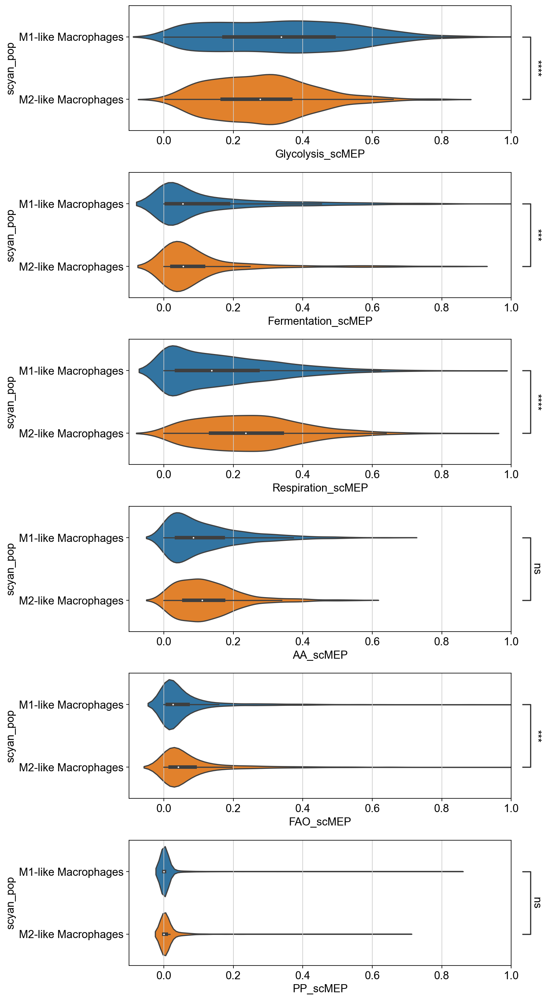

In [61]:
fig, axes = plt.subplots(len(metabolism), figsize=(10,3*len(metabolism)))


for i in range(0,len(metabolism)):
    x = metabolism[i]
    y = 'scyan_pop'
    ax = sns.violinplot(
        data=Macrophages, x=x, y=y, ax=axes[i], orient= 'h'
    )
    ax.set_xlim(-0.1,1)

    #annotator.reset_configuration()
    annotator = Annotator(ax=ax,orient = 'h', data=Macrophages, x=x, y=y, dodge=True, pairs=[('M1-like Macrophages','M2-like Macrophages')], order=['M1-like Macrophages', 'M2-like Macrophages'])
    annotator.configure(test="t-test_ind", text_format='star', loc='outside')
    annotator.configure(comparisons_correction="Bonferroni", verbose=2)
    annotator.apply_and_annotate()
    
fig.tight_layout()

Text(0.5, 1.0, 'Correlation Heatmap')

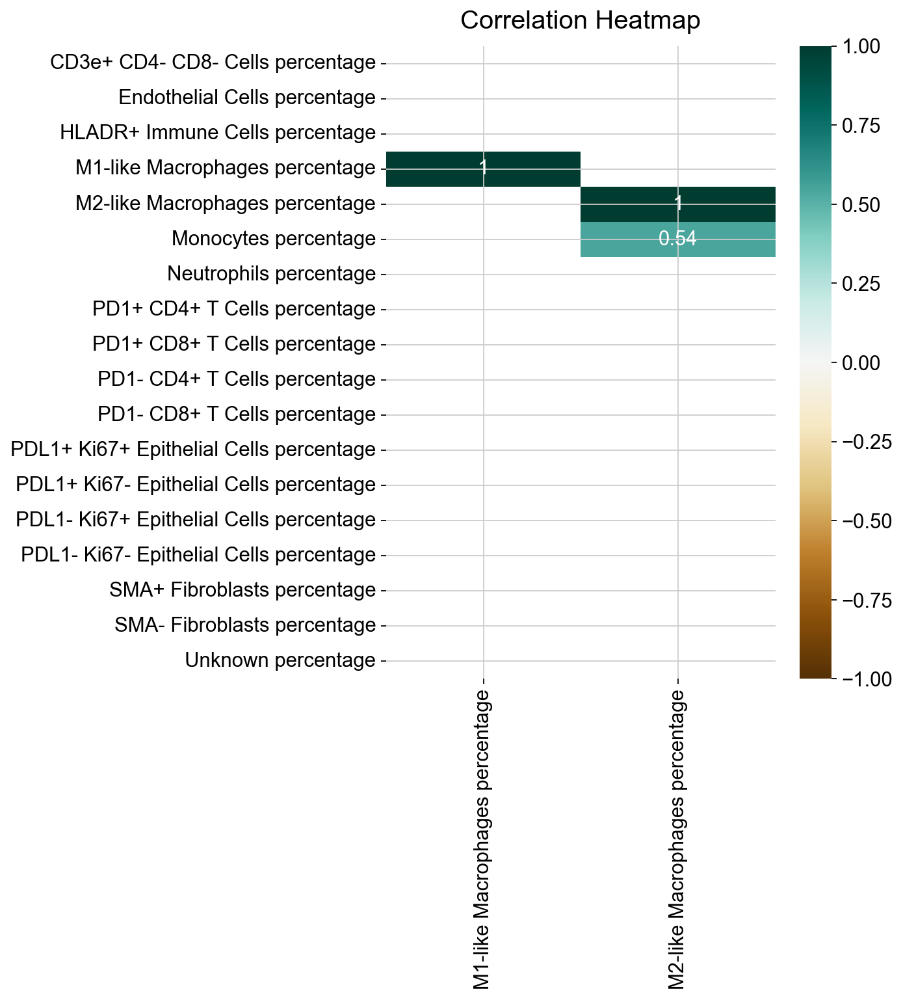

In [62]:
plt.figure(figsize=(6, 8))

mask = np.triu(np.ones_like(scyan.tools.cell_type_ratios(adata, "fov").corr()[['M1-like Macrophages percentage','M2-like Macrophages percentage']], dtype=np.bool))

# get the p value for pearson coefficient, subtract 1 on the diagonal
pvals = scyan.tools.cell_type_ratios(adata, "fov").corr(method=lambda x, y: pearsonr(x, y)[1]) - np.eye(*scyan.tools.cell_type_ratios(adata, "fov").corr().shape)
# set the significance threshold
psig = 0.1

heatmap = sns.heatmap(scyan.tools.cell_type_ratios(adata, "fov").corr()[pvals<psig][['M1-like Macrophages percentage','M2-like Macrophages percentage']],
            mask=mask,
            vmin=-1, 
            vmax=1,
            annot=True,
            cmap='BrBG')

heatmap.set_title('Correlation Heatmap', fontdict={'fontsize':18}, pad=12)

# Tissue aggregation of cell types

In [63]:
adata = sc.read_loom('MIBI_data_analysis.loom', sparse=False, var_names="var_names")

In [ ]:
#Get the proportions of each cell population in every fov

scyan.tools.cell_type_ratios(adata, "fov")

,CD3e+ CD4- CD8- Cells percentage,Endothelial Cells percentage,HLADR+ Immune Cells percentage,M1-like Macrophages percentage,M2-like Macrophages percentage,Monocytes percentage,Neutrophils percentage,PD1+ CD4+ T Cells percentage,PD1+ CD8+ T Cells percentage,PD1- CD4+ T Cells percentage,PD1- CD8+ T Cells percentage,PDL1+ Ki67+ Epithelial Cells percentage,PDL1+ Ki67- Epithelial Cells percentage,PDL1- Ki67+ Epithelial Cells percentage,PDL1- Ki67- Epithelial Cells percentage,SMA+ Fibroblasts percentage,SMA- Fibroblasts percentage,Unknown percentage
fov,,,,,,,,,,,,,,,,,,
BC_B2a,0.011103,0.025233,0.008327,0.028766,0.011355,0.012617,0.003533,0.002019,0.000252,0.004794,0.004037,0.003533,0.005551,0.101943,0.769367,0.000505,0.002523,0.004542
BC_B2b,0.032626,0.044372,0.037194,0.028059,0.003263,0.066232,0.006525,0.005220,0.001958,0.023491,0.032953,0.005220,0.027080,0.020881,0.461338,0.017292,0.180750,0.005546
BC_B2c,0.100000,0.025000,0.099713,0.029598,0.004023,0.062931,0.002874,0.005172,0.013506,0.143103,0.206897,0.001149,0.002874,0.008621,0.228448,0.008333,0.051724,0.006034
BlC_B5a,0.001135,0.024972,0.040106,0.076050,0.013243,0.053727,0.011918,0.016459,0.000189,0.107454,0.002081,0.057321,0.035376,0.149073,0.366250,0.002270,0.038971,0.003405
BlC_B5b,0.006743,0.041958,0.010490,0.007992,0.001499,0.035215,0.073926,0.004246,0.000749,0.017982,0.006494,0.111888,0.130869,0.195804,0.250999,0.067183,0.031469,0.004496
BlC_B5c,0.045103,0.051289,0.001804,0.023454,0.009021,0.073969,0.105412,0.001546,0.013660,0.008505,0.036856,0.036598,0.036598,0.061598,0.463144,0.018814,0.008247,0.004381
CRC_B1a,0.001168,0.017515,0.076600,0.088043,0.003036,0.036665,0.033863,0.002102,0.000701,0.005838,NaN,0.042270,0.048108,0.108127,0.398645,0.081971,0.046474,0.008874
CRC_B1b,0.002994,0.027944,0.007735,0.021707,0.012226,0.066866,0.127495,0.002246,0.000250,0.008733,0.002495,0.027695,0.017715,0.143962,0.476297,NaN,0.048154,0.005489
CRC_B1c,0.012727,0.022451,0.006578,0.012584,0.002288,0.045331,0.311168,0.004576,0.000286,0.051766,0.040326,0.096811,0.174603,0.048191,0.152009,0.008151,0.004433,0.005720


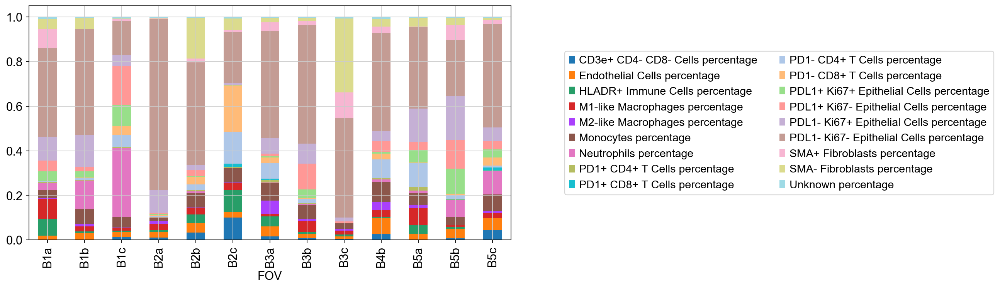

In [ ]:
# create stacked bar chart by tissue
Tissues = scyan.tools.cell_type_ratios(adata, "FOV")

ax = Tissues.plot(kind='bar', stacked=True,figsize = (10,5))
ax.legend(loc='center left', bbox_to_anchor=(1.1, 0.5), ncol=2)

plt.show()

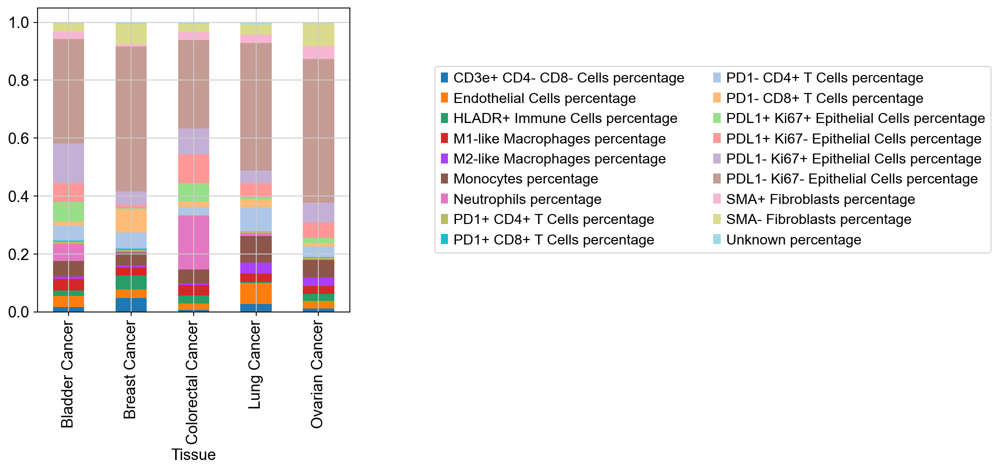

In [ ]:
# create stacked bar chart by Cancer
Tissues = scyan.tools.cell_type_ratios(adata, "Tissue")

ax = Tissues.plot(kind='bar', stacked=True,figsize = (5,5))
ax.legend(loc='center left', bbox_to_anchor=(1.25, 0.5), ncol=2)

plt.show()

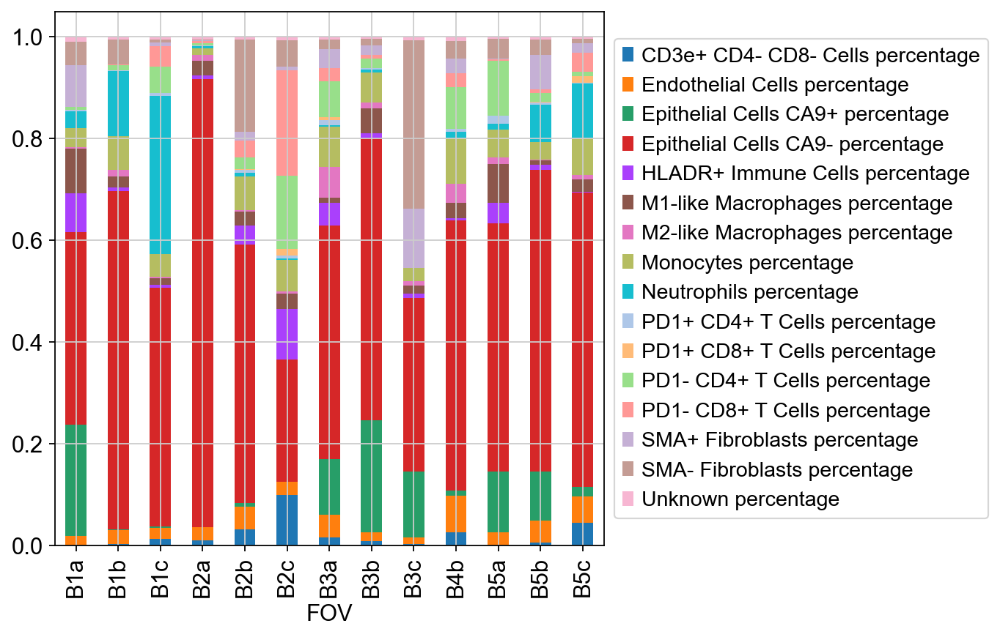

In [ ]:
# create stacked bar chart by tissue
Tissues = scyan.tools.cell_type_ratios(adata, key="phenotype",groupby='FOV')

ax = Tissues.plot(kind='bar', stacked=True,figsize = (6,6))
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5), ncol=1)

plt.show()

In [ ]:
adata.obs['phenotype'] = adata.obs['phenotype'].astype("category")

fov_of_interest = 'OC_B3a'

Fov = adata[adata.obs['fov'].isin([fov_of_interest])]

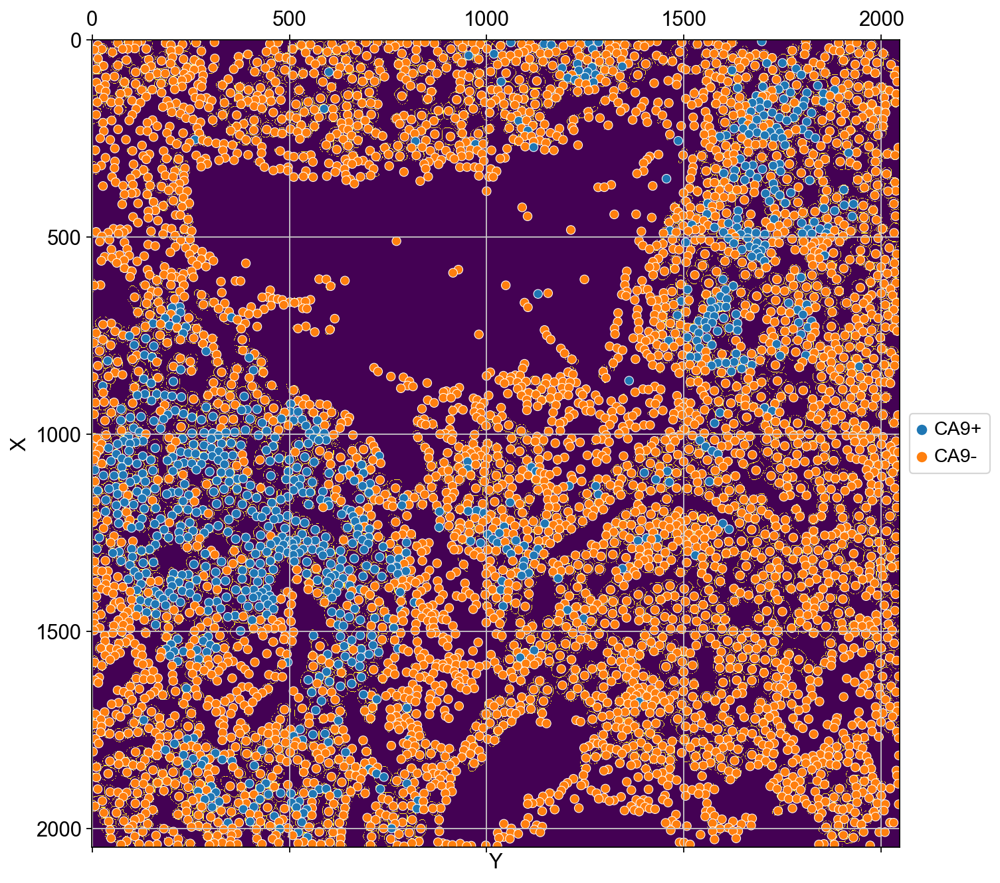

In [ ]:
# Read image segmentation

segmentation = imread(os.path.join(segmentation_dir, fov_of_interest + "_segmentation_borders.tiff"))

#Plot an overlay of the cell populations and cell segmentation

fig, ax =  plt.subplots(1, 1, figsize=(10,10))
ax.matshow(segmentation)

x = sns.scatterplot(x = Fov.obs['Y'], y = Fov.obs['X'], hue = Fov.obs['CA9 State'])
x.legend(loc='center left', bbox_to_anchor=(1, 0.5), ncol=1)

plt.show()

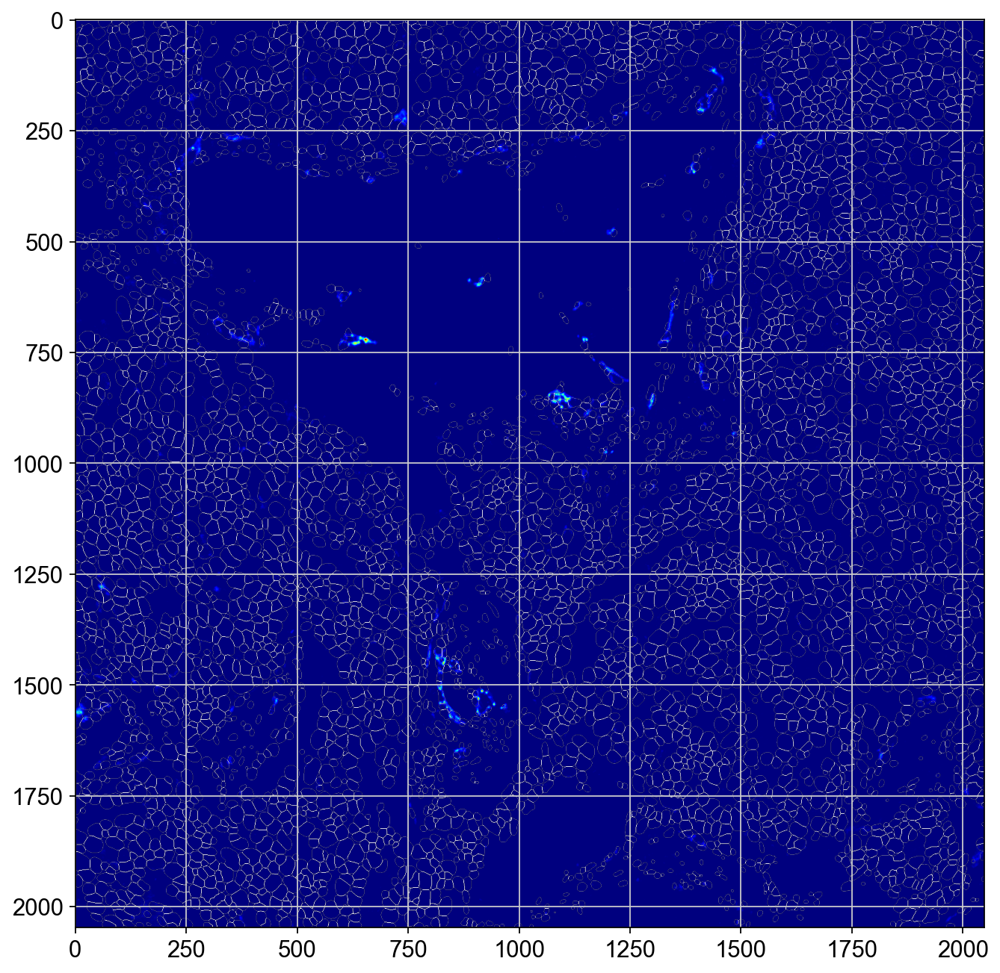

In [ ]:
# Read one marker for the image

img = imread(os.path.join(image_dir, fov_of_interest, "CD31.tiff"))

#Plot an overlay of the marker expression and cell segmentation

fig, ax =  plt.subplots(1, 1, figsize=(10, 10))
plt.imshow(img, cmap='jet')
plt.imshow(segmentation, cmap='gray', alpha=0.9*(segmentation>0) ) 
plt.show()

## Analysis on one FOV using squidpy spatial functions

In [ ]:
sq.gr.spatial_neighbors(Fov)

Creating graph using `generic` coordinates and `None` transform and `1` libraries.
Adding `adata.obsp['spatial_connectivities']`
       `adata.obsp['spatial_distances']`
       `adata.uns['spatial_neighbors']`
Finish (0:00:00)


In [ ]:
sq.gr.nhood_enrichment(Fov, cluster_key="phenotype")

Calculating neighborhood enrichment using `1` core(s)


100%|████████████████████████████████████████| 1000/1000 [00:03<00:00, 300.72/s]


Adding `adata.uns['phenotype_nhood_enrichment']`
Finish (0:00:03)


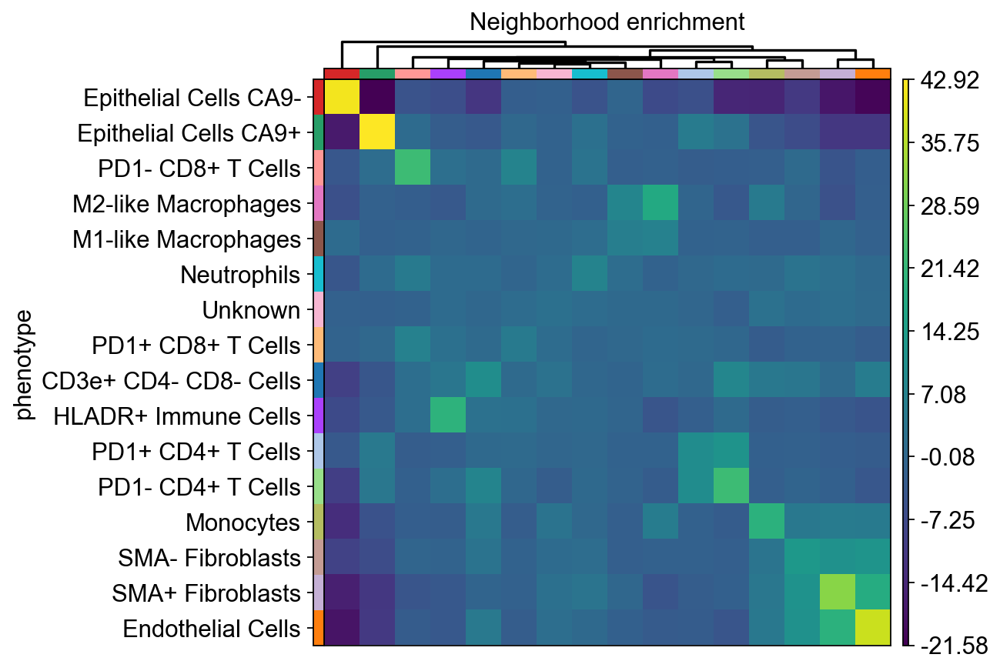

In [ ]:
sq.pl.nhood_enrichment(Fov, cluster_key="phenotype", method="average", figsize=(5, 5))

In [ ]:
sq.gr.interaction_matrix(Fov, cluster_key="phenotype")

Adding `adata.uns['phenotype_interactions']`


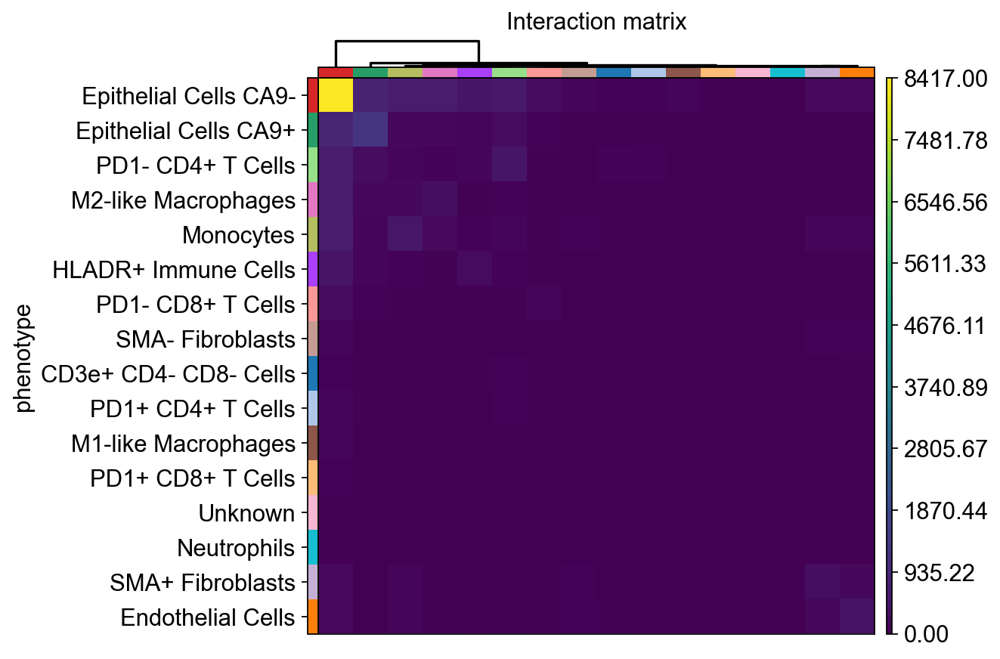

In [ ]:
sq.pl.interaction_matrix(Fov, cluster_key="phenotype", method="average", figsize=(5, 5))

In [ ]:
sq.gr.co_occurrence(Fov, cluster_key="phenotype")

Calculating co-occurrence probabilities for `50` intervals `1` split combinations using `1` core(s)


100%|███████████████████████████████████████████████| 1/1 [00:03<00:00,  3.79s/]


Adding `adata.uns['phenotype_co_occurrence']`
Finish (0:00:04)


ERROR: Unable to fetch palette, reason: 'phenotype_colors'. Using `None`.


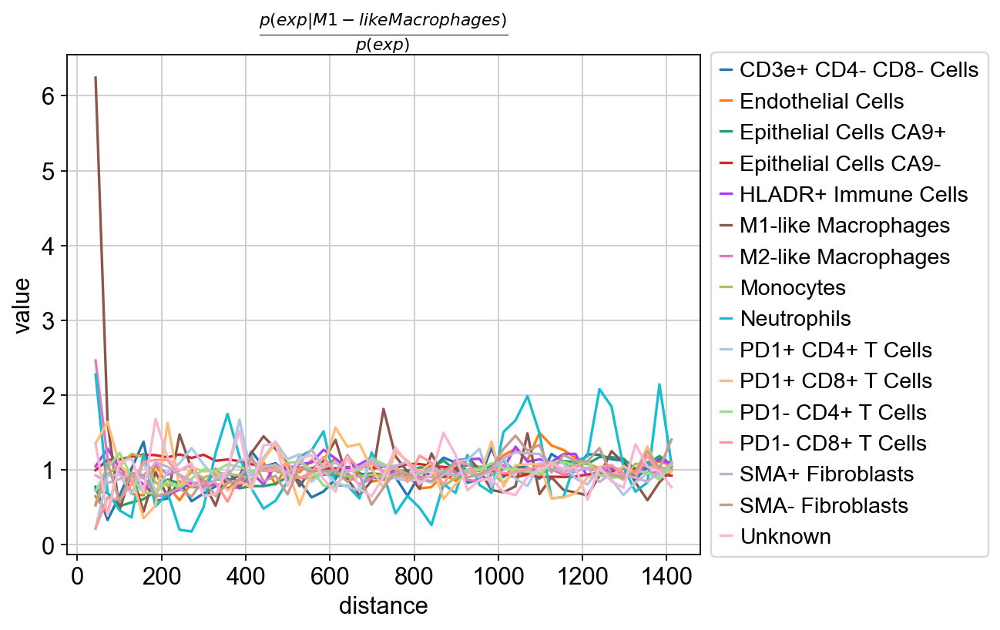

In [ ]:
sq.pl.co_occurrence(Fov, cluster_key="phenotype", clusters="M1-like Macrophages", figsize=(8, 5))

ERROR: Unable to fetch palette, reason: 'phenotype_colors'. Using `None`.


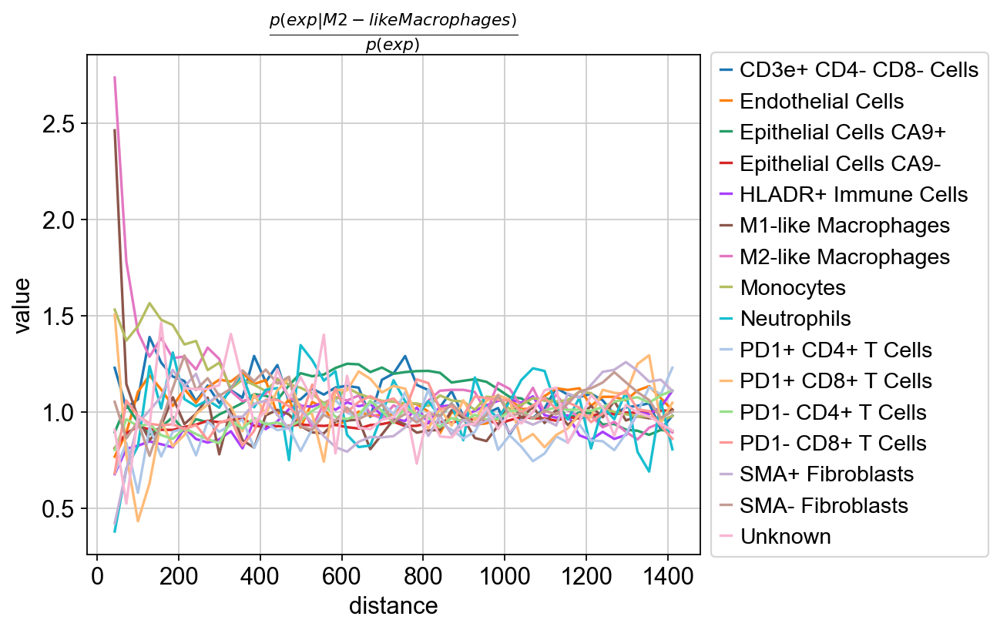

In [ ]:
sq.pl.co_occurrence(Fov, cluster_key="phenotype", clusters="M2-like Macrophages", figsize=(8, 5))

In [ ]:
mode = "L"
sq.gr.ripley(Fov, cluster_key="phenotype", mode=mode)

Calculating Ripley's L statistic for `16` clusters and `100` simulations
Adding `adata.uns['phenotype_ripley_L']`
Finish (0:00:03)


ERROR: Unable to fetch palette, reason: 'phenotype_colors'. Using `None`.


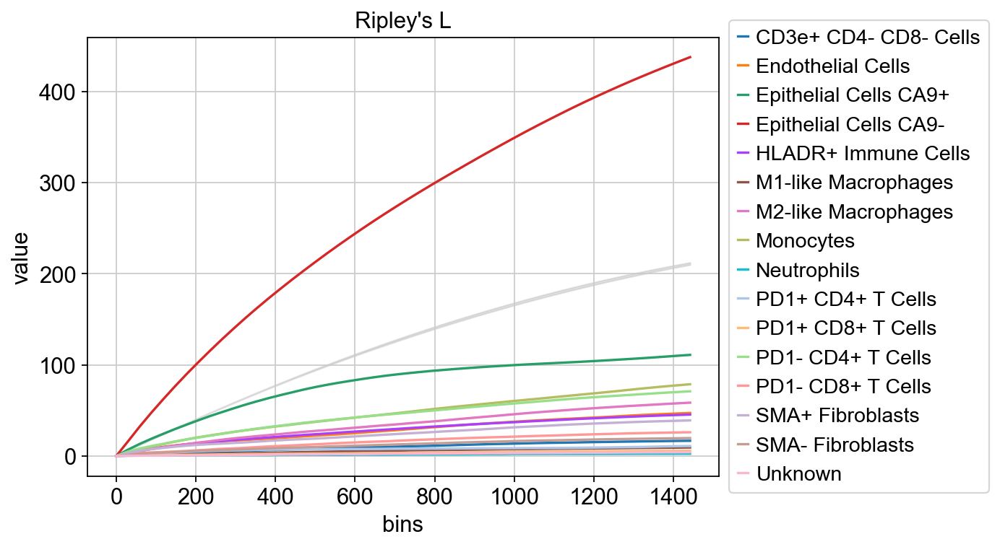

In [ ]:
sq.pl.ripley(Fov, cluster_key="phenotype", mode=mode, figsize=(7, 5))

Calculating centralities `[degree_centrality, average_clustering, closeness_centrality]` using `1` core(s)
Adding `adata.uns['phenotype_centrality_scores']`
Finish (0:00:00)
ERROR: Unable to fetch palette, reason: 'phenotype_colors'. Using `None`.


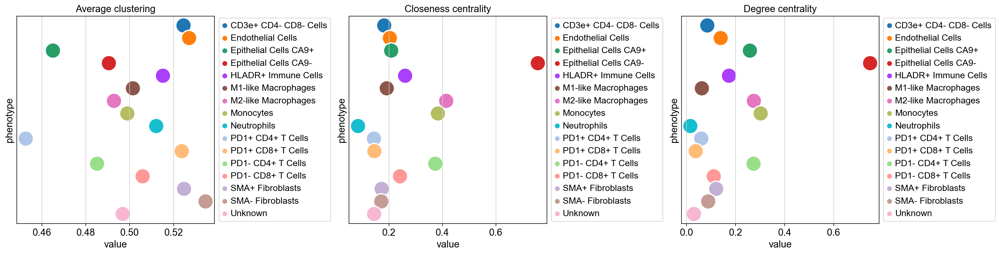

In [ ]:
sq.gr.centrality_scores(
    Fov,
    cluster_key="phenotype"
)

sq.pl.centrality_scores(Fov, cluster_key="phenotype", figsize=(20, 5), s=500)

# Saving cluster information for Inspection on Mantis viewer

In [ ]:
clusters = adata.obs.drop('fov', axis = 1)
df = pd.read_csv(os.path.join(cell_table_dir,'cell_table_size_normalized.csv'))

df_updated = df.join(clusters.reset_index(drop=True))
df_updated.to_csv(os.path.join(cell_table_dir,'cell_table_size_normalized_scyan_annotated.csv'),index=False)

In [ ]:
# Using a dict-comprehension, the unique 'method' value will be the key
clusters_per_fov = {g: d for g, d in df_updated.groupby('fov')}

In [ ]:
clusters_per_fov.keys()

dict_keys(['BC_B2a', 'BC_B2b', 'BC_B2c', 'BlC_B5a', 'BlC_B5b', 'BlC_B5c', 'CRC_B1a', 'CRC_B1b', 'CRC_B1c', 'Colon_A3a', 'Kidney_A2b', 'LC_B4b', 'Liver_A2c', 'Lymphnode_A1c', 'OC_B3a', 'OC_B3b', 'OC_B3c', 'Spleen_A2a', 'Thymus_A1b', 'Tonsil_A1a'])

In [ ]:
one_fov = clusters_per_fov['B1c']
one_fov = one_fov[['scyan_pop']]
one_fov.index = np.arange(1, len(one_fov) + 1)
one_fov.to_csv(os.path.join(cell_table_dir,'B4a.csv'),index=True,header=False)